<img src="https://s3.amazonaws.com/weclouddata/images/logos/wcd_logo_new_2.png" width="10%">
<h1><center>Computer Vision Project Template (Object Tracking)</center></h1>

---

For this notebook, we will be using the Project Template.

The goal of the template is to make the Capstone Project implementation easy for the user.

# ML Project

There are 5 core components of a ML Project:
- Problem Statement
- Dataset
- DL Model
- Model Training
- Model Evaluation

The Template provides wrappers (Data and Model classes) and an API (ModelEngine) that works hand-in-hand with a Configuration. Together, they form a complete Training API.


Download and install the template

In [1]:
# !git clone https://github.com/jjaskirat/wcd_project_template.git
# %cd wcd_project_template
# ! python setup.py install
# %cd ..

In [2]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

%matplotlib inline

imports

In [3]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.optim as optim
from typing import List, Callable

from ltr.data.loader import MultiEpochLTRLoader
from ltr.data import processing, sampler, LTRLoader
from ltr.models.tracking import tamosnet
import ltr.models.loss as ltr_losses
import ltr.actors.tracking as actors
from ltr.trainers import LTRTrainer
import ltr.data.transforms as tfm
from ltr import MultiGPU
from ltr.models.loss.bbr_loss import GIoULoss

from pytracking.evaluation import Sequence
from ltr.dataset.base_video_dataset import BaseVideoDataset
from ltr.data.image_loader import jpeg4py_loader
import torch
from collections import OrderedDict

## Problem Statement

---


What is Drone Traffic Monitoring ?

Drone traffic monitoring uses UAVs to collect real-time data on traffic conditions. These UAVs are equipped with cameras and sensors to monitor traffic flow, congestion, and accidents. The data collected helps optimize traffic management strategies. Moreover, the same technology can be adapted for monitoring of crowds, providing insights into pedestrian crowd dynamics and aiding law enforcement drone teams efforts.

Traffic Congestion in Urban Areas: A Major Problem

Urban areas often experience heavy traffic movement. Continuous lines of vehicles, sounding horns, and delays are frequent. Traffic congestion results in longer travel times, increased pollution, and reduced productivity.

Traditional traffic monitoring often misses the complete picture. UAVs, however, can quickly identify congestion points and help reduce traffic. They also monitor pedestrian crowds, ensuring safe and efficient movement of people during high-density events.

Drones to Monitor and Manage Traffic

UAVs offer a dynamic solution for monitoring traffic and managing it. They fly over congested areas, capturing detailed images and videos. With advanced sensors, UAVs analyze traffic flow patterns and identify bottlenecks, aiding traffic management authorities in making informed decisions. Just as firefighting drones enhance public safety by responding to emergencies, drone crowd monitoring can assess crowd density and movement in real-time.


## Dataset

---

**Content**

The proposed UAVDT benchmark consists of 10 hours of raw videos, from which 100 video sequences of about 80,000 representative frames are selected. The sequences contain between 83 and 2970 frames. The videos are captured by an UAV platform at various urban locations such as squares, arterial streets, toll stations, highways, crossings and T-junctions. The videos sequences are recorded at 30 frames per seconds (fps) with the resolution of 1080*540 pixels.

We annotated about 80,000 frames from the 10 hours raw videos and about 0,84 million bounding boxes over 2,700 vehicles in our dataset. In some areas, the vehicles were too small to analyze their motion or to perform classification on them. For the tracking tasks i.e., MOT and SOT, we define 3 attributes indicating conditions of the scene (Illumination Condition, Flying Altitude and Camera View) and 1 attribute indicating the duration of the sequences (Duration).
Illumination Condition indicates weather conditions, e.g., fog, rain, etc. and the time of the day, e.g., daylight, night. The videos in daylight introduce interference of shadows by the sunshine. In a night scene, under the illumination of dim street lights, objects’ texture information can hardly be captured. The scenes captured in foggy conditions lack details regarding the contours of the objects in the scene. 
Flying Altitude indicates the flying height of UAVs when the videos are captured, i.e., low-alt (< 30m), medium-alt (> 30m and < 70m) and high-alt (> 70m), affecting the scale of the objects. Much more details of objects are captured in low-alt while the object may occupy larger area of the scene, so in the scene, the objects are typically much fewer than in higher height. In high-alt, the size of vehicles is much smaller. For example, the scene could contain more than a hundred tiny objects which respectively contain 0:005% pixels of a frame.
Camera View indicates the way the videos have been recorded, i.e., front-view, side-view and bird-view. In frontview, the camera is aligned with the road. In side-view, the UAV camera is positioned off the axis of the road capturing the side of the objects. In bird-view, the video views are perpendicular to the ground. The camera view could change during the sequence so that both front-view and side-view may be present. Duration indicates the length of a sequence. The robustness of methods could be evaluated in the long term sequences. The sequences containing more than 1500 frames, are tagged with the long-term attribute.

**Acknowledgements**

Data source: https://sites.google.com/view/grli-uavdt/%E9%A6%96%E9%A1%B5


D. Du, Y. Qi, H.g Yu, Y. Yang, K. Duan, G. Li, W.g Zhang, Q. Huang, Q. Tian, " The Unmanned Aerial Vehicle Benchmark: Object Detection and Tracking", European Conference on Computer Vision (ECCV), 2018. 

In [4]:
image = cv2.imread('/data/we_cloud_data/uav_benchmark/UAV-benchmark-M/M0101/img000004.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

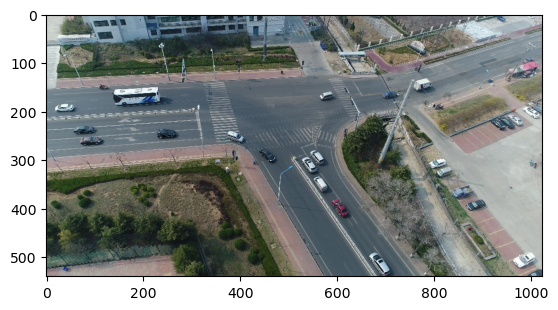

In [5]:
plt.imshow(image)

In [6]:
with open('/data/we_cloud_data/uav_benchmark/UAV-benchmark-MOTD_v1.0/GT/M0101_gt.txt', 'r') as file:
    gt = file.readlines()

In [7]:
frame_idx, target_id, bbox_left, bbox_top, bbox_width, bbox_height, score, in_view, occlusion = gt[3][:-1].split(',')

In [8]:
cv2.rectangle(image,(int(bbox_left),int(bbox_top)),(int(bbox_left)+int(bbox_width),int(bbox_top)+int(bbox_height)), (0,255,0), 2);

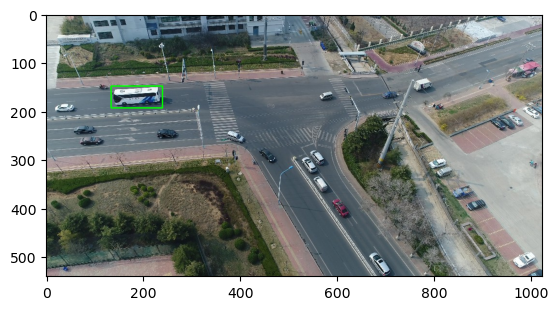

In [9]:
plt.imshow(image)

## Dataset Creation

The template provides a wrapper on top of a torch Dataset.

The user is responsible to create their own dataset and load it in PyTorch.

~~The `Data` class inherits from the `torch.utils.data.Dataset` class. It implements the `__len__` and the `__getitem__` functions. The user must implement the `get_input`, `get_label` and `apply_transform` functions, which define how the input and the labels can be obtained from a `pd.core.frame.DataFrame`~~

The Dataset needs to be created using the `ltr library` since this is a Video Dataset.

PS: The Dataset can still be created using the Template but that will require copying the entire dataset from the ltr library. So, it is recomended to create it this way

To create a Video Dataset, the dataset needs to inherit from `ltr.datset.base_video_dataset.BaseVideoDataset`

There are 3 methods that need to be created here.
- `get_sequence_info`
- `get_frames`
- `get_sequence_list`

##### get_sequence_info
This method returns the information on every video (image sequence) in the dataset

##### get_frames
This method is responsible to return the image frames along with bounding box and mask information

##### get_sequence_list
This method is responsible to return the `Sequence` class from the `ltr` library. The `Sequence` contains information on the same information as the `get_frames` method, but wraps it.

In [10]:
class UAVBenchmarkVIDMOT(BaseVideoDataset):
    def __init__(self, root=None, image_loader=jpeg4py_loader, split=None, multiobj=True):
        super().__init__('UAVBenchmarkVIDMOT', root, image_loader)

        self.multiobj = multiobj
        self.split = split
        # Get names of all sequence folders
        self.sequence_list = os.listdir(f'{root}/UAV-benchmark-M')
        self.num_tracks_per_seq = []
        # Get number of tracks (unique opbjects) in every sequence
        for seq_name in self.sequence_list:
            annotation_path = f'{root}/UAV-benchmark-MOTD_v1.0/GT/{seq_name}_gt.txt'
            annotations = open(annotation_path, 'r').readlines()
            unique_objects = set([anno.split(',')[1] for anno in annotations])
            self.num_tracks_per_seq.append(len(unique_objects))

        self.sequence_infos = {}
        
    def _is_obj_in_frame(self, annotations, frame_name, obj_id):
        """
        returns an int for an object if it is
        present in the frame or not
        """
        frame_name = int(frame_name)
        try:
            anno_for_frame = annotations['labels'][frame_name]
            objs_for_frame = [i[0] for i in anno_for_frame]
            return int(obj_id in objs_for_frame)
        except:
            return 0
            
    def _preload_sequence_info(self, seq_id: int, anno_dict: dict=None) -> dict:
        """loads the information of the sequence
        

        Args:
            seq_id (int): the id of sequence
            anno_dict (dict, optional): annotation dict. Defaults to None.

        Returns:
            dict: sequence information in format:
            {
                'sequence': name of sequence,
                'frame_names': name of all frames in the sequence
                'object_ids': ids of all objects in the sequence
                'visible': tells us if an object is present in the frame or not
                'valid': tells us if the object in frame is valid or not
            }
        """
        info = {}
        # get name of sequence
        seq_name = self.sequence_list[seq_id]
        frame_names = os.listdir(f'{self.root}/UAV-benchmark-M/{seq_name}')
        frame_names = [i[3:].split('.')[0] for i in frame_names]
        # sort the frame names in ascending order
        # Tells us which frame is first and which frame comes after
        # forming a sequence of images to create a video
        frame_names = sorted(frame_names)
        total_frames = len(frame_names)
        # total_frames = len(self.sequence_list)
        if self.split == 'train':
            # Get the first 99% of frames to be the train frames
            train_size = int(0.99*total_frames)
            frame_names = frame_names[:train_size]
        else:
            # Get the last 1% of frames to be the valid frames
            train_size = int(0.99*total_frames)
            frame_names = frame_names[train_size:]
        # Get annotation of frames
        anno_path = self._get_annotation_path(seq_id)
        anno = self._get_annotation(anno_path)
        unique_objects = anno['unique_objects']
        # Check if they are visible in frame or not
        visible = [
            [self._is_obj_in_frame(anno, frame_name, obj_id) for obj_id in unique_objects]
            for frame_name in frame_names
        ]
        visible = torch.Tensor(visible)
        info['sequence'] = seq_name
        info['frame_names'] = frame_names
        info['object_ids'] = unique_objects
        info['visible'] = visible
        # All annotations are valid
        info['valid'] = torch.ones_like(visible)
        
        return info

    def is_mot_dataset(self):
        return self.multiobj

    def get_name(self):
        return 'UAVBenchmarkVIDMOT'

    def get_num_sequences(self):
        return len(self.sequence_list)

    def get_sequence_info(self, seq_id):
        if seq_id not in self.sequence_infos:
            self.sequence_infos[seq_id] = self._preload_sequence_info(seq_id)

        return self.sequence_infos[seq_id]

    def _get_frame(self, seq_path, frame_id):
        frame_path = self._get_frame_path(seq_path, frame_id)
        return self.image_loader(frame_path)

    def _get_sequence_path(self, seq_id):
        seq_name = self.sequence_list[seq_id]
        return f'{self.root}/UAV-benchmark-M/{seq_name}'

    def _get_frame_path(self, seq_path, frame_id):
        return os.path.join(seq_path, f'img{frame_id}.jpg')
    
    def _get_annotation_path(self, seq_id):
        seq_name = self.sequence_list[seq_id]
        return f'{self.root}/UAV-benchmark-MOTD_v1.0/GT/{seq_name}_gt.txt'
    
    def _get_annotation(self, annotation_path: os.PathLike[str])->dict:
        """gets the annotation from a annotation txt file
        the annotation is converted into a dict where the key is the frame_id
        this leads to O(1) to get annotation on the frame

        Args:
            annotation_path (os.PathLike[str]): path to file

        Returns:
            dict: annotation = {
                'labels' : bounding boxes per frame (dict)
                'unique objects in the frame'
            }
        """
        with open(annotation_path, 'r') as file:
            annotation_list = file.readlines()
        annotation_dict = {
            'labels': {},
            'unique_objects': []
        }
        unique_objects = set()
        # Loop through all lines in the file
        for anno in annotation_list:
            # Create dict of annotations
            frame_idx, target_id, bbox_left, bbox_top, bbox_width, bbox_height, score, in_view, occlusion = anno[:-1].split(',')
            if int(frame_idx) in annotation_dict['labels']:
                annotation_dict['labels'][int(frame_idx)].append((target_id, int(bbox_left), int(bbox_top), int(bbox_width), int(bbox_height)))
            else:
                annotation_dict['labels'][int(frame_idx)] = [(target_id, int(bbox_left), int(bbox_top), int(bbox_width), int(bbox_height))]
            # add object in unique_objects
            unique_objects.add(target_id)
        # Sort unique objects
        annotation_dict['unique_objects'] = sorted(unique_objects, key=lambda x: int(x))
        return annotation_dict
    
    def _get_annotation_frame(self, annotation: dict, frame_id: int, object_ids: list)->dict:
        """get the annoations for each frame
        if the object_id is not present in the frame,
        its bounding box is [-1,-1,-1,-1]

        Args:
            annotation (dict): annotation of the sequence
            frame_id (int): frame id to get the annotations for
            object_ids (list): unique_ids

        Returns:
            dict: returns a dict of bounding boxes for each object_id
        """
        frame_bboxes = {}
        # if the object is present in frame
        # get its bounding box
        if int(frame_id) in annotation['labels']:
            anno_for_frame = annotation['labels'][int(frame_id)]
            for anno in anno_for_frame:
                target_id, bbox_left, bbox_top, bbox_width, bbox_height = anno
                frame_bboxes[target_id] = torch.Tensor(
                    [
                        bbox_left,
                        bbox_top,
                        bbox_width,
                        bbox_height
                    ]
                )
        # if object is not present in frame
        # its bounding box is [-1,-1,-1,-1]
        for target_id in object_ids:
            if target_id not in frame_bboxes:
                frame_bboxes[target_id] = torch.Tensor([-1,-1,-1,-1])
        return frame_bboxes

    def get_frames(self, seq_id: int, frame_ids: List[int], anno=None)-> tuple:
        """gets the frames for the sequence id
        we get the frames according to frame_ids
        (which is the index for the frame ids to get)

        Args:
            seq_id (int): sequence id
            frame_ids (List[int]): indexes of frames to get
            anno (_type_, optional): annotation. Defaults to None.

        Returns:
            tuple: (
                frame_list: images of each frame
                anno_dict: annotations of each frame
                object_meta: meta information (get_seq_info)
            )
        """
        # get meta information
        meta = self.get_sequence_info(seq_id)
        # Get desired frames
        frame_names = np.array(meta['frame_names'])[frame_ids]
        # Get path of sequence
        seq_path = self._get_sequence_path(seq_id)
        # Get all frame images
        frame_list = [self._get_frame(seq_path, f_id) for f_id in frame_names]
        
        # get annotation
        if anno is None:
            anno_path = self._get_annotation_path(seq_id)
            anno = self._get_annotation(anno_path)

        # Create anno dict
        anno_dict = {}
        # Get annotation of the desired frames
        anno_dict['bbox'] = [self._get_annotation_frame(anno, f_id, meta['object_ids']) for f_id in frame_names]
        # If there is a mask assiciated
        # anno_dict['mask'] = self.get_mask(...)
        anno_dict['visible'] = meta['visible'][frame_ids]
        anno_dict['valid'] = meta['valid']

        object_meta = {key: meta[key] for key in ['sequence', 'frame_names', 'object_ids']}

        return frame_list, anno_dict, object_meta
    
    def get_sequence_list(self):
        """generates the sequence list of all frames

        Returns:
            List: list of Sequence class
        """
        sequence_list = []
        for i in range(len(self.sequence_list)):
            seq = self._construct_sequence(i)
            if seq is not None:
                sequence_list.append(seq)
        return sequence_list
    
    def _construct_sequence(self, seq_id) -> Sequence:
        """constructs the Sequence wrapper for the frames

        Args:
            seq_id (int): sequence id

        Returns:
            Sequence: frames wrapped in the Sequence Class
        """
        sequence_info = self.get_sequence_info(seq_id)
        seq_name = sequence_info['sequence']
        frame_names = sequence_info['frame_names']
        fname_to_fid = {f: i for i, f in enumerate(frame_names)}
        images, anno_dict, object_meta = self.get_frames(seq_id, range(len(frame_names)))
        # Get information on the first frame
        init_data = dict()
        all_obj_ids = set()
        anno_path = self._get_annotation_path(seq_id)
        anno = self._get_annotation(anno_path)
        for obj_id in sequence_info['object_ids']:
            if obj_id == '0':
                print("!")
            f_name = frame_names[0]
            if not self._is_obj_in_frame(anno, f_name, obj_id):
                continue
            f_id = fname_to_fid[f_name]
            if f_id not in init_data:
                init_data[f_id] = {'object_ids': [obj_id],
                                   'bbox': {obj_id: anno_dict['bbox'][0][obj_id]},
                                #    'mask': ...
                                }
                all_obj_ids.add(obj_id)
            else:
                if len(init_data[f_id]['object_ids']) == 10:
                    continue
                all_obj_ids.add(obj_id)
                init_data[f_id]['object_ids'].append(obj_id)
                init_data[f_id]['bbox'][obj_id] = anno_dict['bbox'][0][obj_id]
                # init_data[f_id]['mask'][obj_id] = ...
        try:
            return Sequence(name=seq_name, frames=images, dataset='UAVBenchmarkVIDMOT', ground_truth_rect=anno_dict,
                            init_data=init_data, object_ids=list(all_obj_ids),
                            multiobj_mode=self.multiobj)
        except:
            return None

To incorporate the Dataset in the Template, the dataset needs to have the `get_dataloader` function

So, we use the Dataset(sampler) provided in the library and extend it to create that function

Note: Dataloader for train and valid datasets is different

In [11]:
class DataObjectDetectionTrain(sampler.TaMOsDatasetSampler):
    def __init__(self, config):
        super().__init__(**config['dataset'])
        self.config = config
        
    def get_dataloader(self):
        dataloader = MultiEpochLTRLoader(dataset = self, **self.config['dataloader'])
        return dataloader
        
class DataObjectDetectionValid(sampler.TaMOsDatasetSampler):
    def __init__(self, config):
        super().__init__(**config['dataset'])
        self.config = config
        
    def get_dataloader(self):
        dataloader = LTRLoader(dataset = self, **self.config['dataloader'])
        return dataloader

##### Define the transforms and preprocessing for the dataset

Note: The transforms and preprocessing are different for every model.

Please refer to https://github.com/visionml/pytracking/tree/master/ltr/train_settings for the settings for each Model

All hyperparameters are copied from the respective files

In [12]:
# Data transform
transform_joint = tfm.Transform(
    tfm.ToGrayscale(probability=0.05),
    tfm.RandomHorizontalFlip(probability=0.5)
)

transform_train = tfm.Transform(
    tfm.RandomAffine(p_flip=0.5, max_rotation=1.0, max_scale=np.log(1.5), scale_center=0.5),
    tfm.ToTensorAndJitter(0.2),
    tfm.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

transform_val = tfm.Transform(
    tfm.ToTensor(),
    tfm.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

feature_sz = (36, 24)
# The tracking pairs processing module
output_sigma = (1/4) / (5.0)
label_params = {'feature_sz': feature_sz, 'sigma_factor': output_sigma,
                'kernel_sz': 1}

data_processing_train = processing.TaMOsProcessing(
    max_num_objects=10,
    search_area_factor=5.0,
    output_sz=(16 * feature_sz[0], 16 * feature_sz[1]),
    center_jitter_factor={'train': 0., 'test': 4.5},
    scale_jitter_factor={'train': 0., 'test': 0.5},
    crop_type='inside_major',
    max_scale_change=1.5,
    mode='sequence',
    label_function_params=label_params,
    transform=transform_train,
    joint_transform=transform_joint,
    use_normalized_coords=True,
    center_sampling_radius=1.0,
    include_high_res_labels=True,
    enforce_one_sample_region_per_object=True
)

data_processing_val = processing.TaMOsProcessing(
    max_num_objects=10,
    search_area_factor=5.0,
    output_sz=(16 * feature_sz[0], 16 * feature_sz[1]),
    center_jitter_factor={'train': 0., 'test': 4.5},
    scale_jitter_factor={'train': 0., 'test': 0.5},
    crop_type='inside_major',
    max_scale_change=1.5,
    mode='sequence',
    label_function_params=label_params,
    transform=transform_val,
    joint_transform=transform_joint,
    use_normalized_coords=True,
    center_sampling_radius=1.0,
    include_high_res_labels=True,
    enforce_one_sample_region_per_object=True
)

##### Create the Dataset

In [13]:
# Train Dataset
uav_benchmark_train = UAVBenchmarkVIDMOT('/data/we_cloud_data/uav_benchmark', split='train')
# Valid Dataset
uav_benchmark_valid = UAVBenchmarkVIDMOT('/data/we_cloud_data/uav_benchmark', split='valid')

In [14]:
# Training Data config
config_dataset_train = {
    'dataset': {
        'datasets': [uav_benchmark_train],
        'p_datasets': [1],
        'samples_per_epoch': 2000,
        'max_gap': {'sot': 200, 'mot': 100},
        'num_test_frames': 1,
        'num_train_frames': 1,
        'processing': data_processing_train,
        'frame_sample_mode': 'causal',
        'buffer_size': 160,
        'use_gap': False,
    },
    'dataloader': {
        'name': 'train',
        'training': True,
        'batch_size': 8,
        'num_workers': 0,
        'shuffle': True,
        'drop_last': True,
        'stack_dim': 1,
    },
}

# Validation data config
config_dataset_valid = {
    'dataset': {
        'datasets': [uav_benchmark_valid],
        'p_datasets': [1],
        'samples_per_epoch': 200,
        'max_gap': {'sot': 200, 'mot': 100},
        'num_test_frames': 1,
        'num_train_frames': 1,
        'processing': data_processing_val
    },
    'dataloader': {
        'name': 'val',
        'training': False,
        'batch_size': 8,
        'num_workers': 0,
        'shuffle': False,
        'drop_last': True,
        'epoch_interval': 1,
        'stack_dim': 1
    }
}

In [15]:
uav_benchmark_valid.get_sequence_info(0)

{'sequence': 'M0202',
 'frame_names': ['000289', '000290', '000291'],
 'object_ids': ['1',
  '2',
  '3',
  '4',
  '5',
  '6',
  '7',
  '8',
  '9',
  '10',
  '11',
  '12',
  '13',
  '14',
  '15',
  '16',
  '17',
  '18',
  '19',
  '20',
  '21',
  '22',
  '23'],
 'visible': tensor([[1., 0., 1., 0., 0., 0., 0., 1., 0., 1., 0., 1., 0., 1., 1., 0., 0., 0.,
          1., 1., 1., 1., 1.],
         [1., 0., 1., 0., 0., 0., 0., 1., 0., 1., 0., 1., 0., 1., 1., 0., 0., 0.,
          1., 1., 1., 1., 1.],
         [1., 0., 1., 0., 0., 0., 0., 1., 0., 1., 0., 1., 0., 1., 1., 0., 0., 0.,
          1., 1., 1., 1., 1.]]),
 'valid': tensor([[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
          1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
          1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
          1., 1., 1., 1., 1.]])}

In [16]:
# Training Data
data_train = DataObjectDetectionTrain(
    config_dataset_train
)
# Validation Data
data_valid = DataObjectDetectionValid(
    config_dataset_valid
)

## DL Model

---

he template provides a wrapper on top of a torch model. The template provides the usage of 4 different libraries:
- `timm`, `segmentation-models-pytorch`, `torchvision.detection` and `pytracking`

For Object Detection Tracking:
- torchvision.detection
    - [Github and Documentation](https://github.com/visionml/pytracking/tree/master)
    - Medium sized list of Object Tracking models,
    - Ex: ATOM, TaMOs, TOmP, RTS, KeepTrack, etc

Please refer to https://github.com/visionml/pytracking/tree/master/ltr/train_settings for the settings for each Model

All hyperparameters are copied from the respective files

The pretrained model can be downloaded from https://github.com/visionml/pytracking/tree/master/pytracking

In [17]:
# Once downloaded, the model can be loaded by:

# from wcd_project_template.model import Model
# from pytracking.features.net_wrappers import NetWithBackbone
# pretrained_model = NetWithBackbone(net_path=model_path)
# net = pretrained_model.load_network().net
# model = Model(net, config_model)
# torch.save(model, new_model_path)

# Then the new_model_path is the pretrained path

In [18]:
# Import Model from the template
from wcd_project_template.model import Model

In [19]:
config_model = {
    'model_hyperparameters':{
        'filter_size': 1,
        'backbone_pretrained': True,
        'head_feat_blocks': 0,
        'head_feat_norm': True,
        'final_conv': True,
        'out_feature_dim': 256,
        'feature_sz': feature_sz,
        'frozen_backbone_layers': ['conv1', 'layer1', 'layer2', 'layer4', 'bn1'],
        'num_encoder_layers': 6,
        'num_decoder_layers': 6,
        'head_layer': ['layer2', 'layer3'],
        'num_tokens': 10,
        'label_enc': 'gaussian',
        'box_enc': 'ltrb_token',
        'fpn_head_cls_output_mode': ['low', 'high', 'trafo'],
        'fpn_head_bbreg_output_mode': ['low', 'high', 'trafo']
    },
    'weights_path': 'pretrained_tamos.pth',
    'freeze_layers': [
        'feature_extractor.conv1',
        'feature_extractor.bn1',
        'feature_extractor.layer1',
        'feature_extractor.layer2',
        'feature_extractor.layer4'
    ],
}

# Create network and actor
model_ = tamosnet.tamosnet_resnet50(
    **config_model['model_hyperparameters']
)

model = Model(model_, config_model)

using lin_sine as positional encoding


/wcd_project_template/wcd_project_template/model.py:26: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(weights_path))


done loading model


## Model Training

---

The template provides you with a `ModelEngine` class. This class is responsible for supervised model training and evaluation. The code for training or evaluating the model is generally the same for every model. The components that change are the `Loss`, `Metric` and `Optimizer`.
- Loss
    - The loss function can be imported from any library
    - It can also be a custom loss function as seen [here](https://discuss.pytorch.org/t/custom-loss-functions/29387/2)
- Metric
    - Any metric can be used from the library `torchmetrics`.
    - Options for a custom metric are also provided [here](https://lightning.ai/docs/torchmetrics/stable/pages/implement.html)
- Optimizer
    - The optimizer must be from the `torch.optim` module.
    - Any optimizer can be selected
    - Options for a custom optimizer are also provided on the docs

### For Object Tracking

- Loss
    - The loss function for every Model is different.
    It is copied from: https://github.com/visionml/pytracking/blob/master/ltr/actors/tracking.py

- Metric
    - The metric function for every Model is different.
    It is copied from: https://github.com/visionml/pytracking/blob/master/ltr/actors/tracking.py

- Optimizer
    - We use the standard AdamW Optimizer

In [20]:
# Import ModelEngine from the template
from wcd_project_template.model_engine import ModelEngine

/opt/conda/lib/python3.11/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [21]:
# Loss  ------------------------
# This is the TaMOs Loss
# This class calculates the loss as shown in the respective file
class TaMOsLoss:
    def __init__(self, objective, loss_weight, fg_cls_loss):
        self.objective = objective
        self.loss_weight = loss_weight
        self.fg_cls_loss = fg_cls_loss
        
    def compute_cls_loss(self, test_label, target_scores, test_anno, test_sample_region):
        test_label = test_label.flatten(1, 2)
        target_scores = target_scores.flatten(1, 2)
        test_sample_region = test_sample_region.flatten(1, 2)
        if self.fg_cls_loss:
            fg_mask = torch.sum(test_sample_region[0], dim=(1, 2)) > 0
            target_scores = target_scores[:, fg_mask]
            test_label = test_label[:, fg_mask]

        clf_loss_test = self.objective['test_clf'](target_scores, test_label, test_anno)
        return clf_loss_test

    def compute_bbreg_loss(self, test_ltrb_target, test_sample_region, bbox_preds):
        test_ltrb_target = test_ltrb_target.flatten(1, 2)
        test_sample_region = test_sample_region.flatten(1, 2)
        bbox_preds = bbox_preds.flatten(1, 2)
        loss_giou, ious = self.objective['giou'](bbox_preds, test_ltrb_target, test_sample_region)
        return loss_giou, ious
    
    def __call__(self, output, label):
        # losses = sum(loss for loss in output.values())
        # return losses
        target_scores, bbox_preds = output
        clf_loss_test, loss_giou = 0, 0
        if 'trafo' in target_scores:
            clf_loss_test_trafo = self.compute_cls_loss(
                label['test_label'],
                target_scores['trafo'],
                label['test_anno'],
                label['test_sample_region']
            )
            clf_loss_test += clf_loss_test_trafo

        if 'lowres' in target_scores:
            clf_loss_test_lowres = self.compute_cls_loss(
                label['test_label'],
                target_scores['lowres'],
                label['test_anno'],
                label['test_sample_region']
            )
            clf_loss_test += clf_loss_test_lowres

        if 'highres' in target_scores:
            clf_loss_test_highres = self.compute_cls_loss(
                label['test_label_highres'],
                target_scores['highres'],
                label['test_anno'],
                label['test_sample_region_highres']
            )
            clf_loss_test += clf_loss_test_highres

        if 'trafo' in bbox_preds:
            loss_giou_trafo, ious_trafo = self.compute_bbreg_loss(
                label['test_ltrb_target'],
                label['test_sample_region'],
                bbox_preds['trafo']
            )
            # stats['mIoU_trafo'] = ious_trafo.mean().item()
            loss_giou += loss_giou_trafo

        if 'lowres' in bbox_preds:
            loss_giou_lowres, ious_lowres = self.compute_bbreg_loss(
                label['test_ltrb_target'],
                label['test_sample_region'],
                bbox_preds['lowres']
            )
            # stats['mIoU_lowres'] = ious_lowres.mean().item()
            loss_giou += loss_giou_lowres

        if 'highres' in bbox_preds:
            loss_giou_highres, ious_highres = self.compute_bbreg_loss(
                label['test_ltrb_target_highres'],
                label['test_sample_region_highres'],
                bbox_preds['highres']
            )
            # stats['mIoU_highres'] = ious_highres.mean().item()
            # stats['Loss/weighted_GIoU_highres'] = self.loss_weight['giou'] * loss_giou_highres.item()
            loss_giou += loss_giou_highres
            
        loss = self.loss_weight['giou'] * loss_giou + self.loss_weight['test_clf'] * clf_loss_test
        if torch.isnan(loss):
            raise ValueError('NaN detected in loss')
        return loss

In [22]:
# Metric  ------------------------
# This is the TaMOs Metric
# This class calculates the metric as shown in the respective file

import torch.nn.functional as F

class TaMOsMetrics():
    def __init__(self, objective, **kwargs):
        super().__init__(**kwargs)
        self.objective = objective     

    def update(self, output: torch.Tensor, label: torch.Tensor) -> None:
        target_scores, bbox_preds = output
        if 'trafo' in bbox_preds:
            loss_giou_trafo, ious_trafo = self.compute_bbreg_loss(
                label['test_ltrb_target'],
                label['test_sample_region'],
                bbox_preds['trafo']
            )
            self.mIoU_trafo = ious_trafo.mean().item()
            # loss_giou += loss_giou_trafo

        if 'lowres' in bbox_preds:
            loss_giou_lowres, ious_lowres = self.compute_bbreg_loss(
                label['test_ltrb_target'],
                label['test_sample_region'],
                bbox_preds['lowres']
            )
            self.mIoU_lowres = ious_lowres.mean().item()
            # loss_giou += loss_giou_lowres

        if 'highres' in bbox_preds:
            loss_giou_highres, ious_highres = self.compute_bbreg_loss(
                label['test_ltrb_target_highres'],
                label['test_sample_region_highres'],
                bbox_preds['highres']
            )
            self.mIoU_highres = ious_highres.mean().item()
            # self.Loss_weighted_GIoU_highres = self.loss_weight['giou'] * loss_giou_highres.item()
            # loss_giou += loss_giou_highres
        if 'trafo' in target_scores and 'trafo' in bbox_preds:
            ious_pred_center_trafo = self.compute_iou_pred(
                target_scores['trafo'],
                bbox_preds['trafo'],
                label['test_ltrb_target'],
                label['test_sample_region']
            )
            self.mIoU_pred_center_trafo = ious_pred_center_trafo.mean().item()

        if 'lowres' in target_scores and 'lowres' in bbox_preds:
            ious_pred_center_lowres = self.compute_iou_pred(
                target_scores['lowres'],
                bbox_preds['lowres'],
                label['test_ltrb_target'],
                label['test_sample_region']
            )
            self.mIoU_pred_center_lowres = ious_pred_center_lowres.mean().item()

        if 'highres' in target_scores and 'highres' in bbox_preds:
            ious_pred_center_highres = self.compute_iou_pred(
                target_scores['highres'],
                bbox_preds['highres'],
                label['test_ltrb_target_highres'],
                label['test_sample_region_highres']
            )
            self.mIoU_pred_center_highres = ious_pred_center_highres.mean().item()

        if 'highres' not in target_scores and 'highres' in bbox_preds:
            if 'trafo' in target_scores:
                target_scores_trafo = target_scores['trafo'].flatten(1, 2)
                target_scores_trafo_interp = F.interpolate(
                    target_scores_trafo,
                    label['test_ltrb_target_highres'].shape[-2:], mode='bicubic')

                ious_pred_center_highres = self.compute_iou_pred(
                    target_scores_trafo_interp.reshape(
                        label['test_sample_region_highres'].shape
                    ),
                    bbox_preds['highres'],
                    label['test_ltrb_target_highres'],
                    label['test_sample_region_highres']
                )
                self.mIoU_pred_center_trafo_highres = ious_pred_center_highres.mean().item()

            if 'lowres' in target_scores:
                target_scores_lowres = target_scores['lowres'].flatten(1, 2)
                target_scores_lowres_interp = F.interpolate(
                    target_scores_lowres,
                    label['test_ltrb_target_highres'].shape[-2:], mode='bicubic')

                ious_pred_center_highres = self.compute_iou_pred(
                    target_scores_lowres_interp.reshape(
                        label['test_sample_region_highres'].shape
                    ),
                    bbox_preds['highres'],
                    label['test_ltrb_target_highres'],
                    label['test_sample_region_highres']
                )
                self.mIoU_pred_center_lowres_highres = ious_pred_center_highres.mean().item()

    def __call__(self, output, label) -> torch.Tensor:
        self.update(output, label)
        return {
            'mIoU_trafo': torch.Tensor([self.mIoU_trafo]),
            'mIoU_lowres': torch.Tensor([self.mIoU_lowres]),
            'mIoU_highres': torch.Tensor([self.mIoU_highres]),
            # 'Loss_weighted_GIoU_highres': torch.Tensor(self.Loss_weighted_GIoU_highres),
            'mIoU_pred_center_trafo': torch.Tensor([self.mIoU_pred_center_trafo]),
            'mIoU_pred_center_lowres': torch.Tensor([self.mIoU_pred_center_lowres]),
            'mIoU_pred_center_highres': torch.Tensor([self.mIoU_pred_center_highres]),
            # 'mIoU_pred_center_trafo_highres': self.mIoU_pred_center_trafo_highres,
            # 'mIoU_pred_center_lowres_highres': self.mIoU_pred_center_lowres_highres,
        }
        
    def to(self, *args, **kwargs):
        return self
    
    def compute_bbreg_loss(self, test_ltrb_target, test_sample_region, bbox_preds):
        test_ltrb_target = test_ltrb_target.flatten(1, 2)
        test_sample_region = test_sample_region.flatten(1, 2)
        bbox_preds = bbox_preds.flatten(1, 2)
        loss_giou, ious = self.objective['giou'](bbox_preds, test_ltrb_target, test_sample_region)
        return loss_giou, ious
    
    def compute_iou_at_max_score_pos(self, scores, ltrb_gth, ltrb_pred):
        if ltrb_pred.dim() == 4:
            ltrb_pred = ltrb_pred.unsqueeze(0)

        n = scores.shape[1]
        ids = scores.reshape(1, n, -1).max(dim=2)[1]
        g = ltrb_gth.flatten(3)[0, torch.arange(0, n), :, ids].view(1, n, 4, 1, 1)
        p = ltrb_pred.flatten(3)[0, torch.arange(0, n), :, ids].view(1, n, 4, 1, 1)

        _, ious_pred_center = self.objective['giou'](p, g)  # nf x ns x x 4 x h x w
        ious_pred_center[g.view(n, 4).min(dim=1)[0] < 0] = 0

        return ious_pred_center
    
    def compute_iou_pred(self, target_scores, bbox_preds, test_ltrb_target, test_sample_region):
        target_scores = target_scores.flatten(1, 2)
        test_ltrb_target = test_ltrb_target.flatten(1, 2)
        test_sample_region = test_sample_region.flatten(1, 2)
        bbox_preds = bbox_preds.flatten(1, 2)
        fg_mask = torch.sum(test_sample_region[0], dim=(1, 2)) > 0
        return self.compute_iou_at_max_score_pos(target_scores[:, fg_mask], test_ltrb_target[:, fg_mask],
                                                    bbox_preds[:, fg_mask])

We need to modify how the model is called

In [23]:
import copy
class ModelEngineObjectTracking(ModelEngine):
    # During training mode, the input to the model is *(input, label)
    # The model accepts both the input and the label as parameters to the forward call
    def preprocess_data_for_training(self, item):
        input = copy.deepcopy(item).to(self.device)
        label = copy.deepcopy(item).to(self.device)
        return input, label
    
    def preprocess_data_for_prediction(self, item):
        # During training mode, the input to the model is input
        # The model accepts only the input as parameter to the forward call
        input = copy.deepcopy(item).to(self.device)
        label = copy.deepcopy(item).to(self.device)
        return input, label
    
    def _call_model(self, model, input):
        target_scores, bbox_preds = model(
            train_imgs=input['train_images'],
            test_imgs=input['test_images'],
            train_bb=input['train_anno'],
            train_label=input['train_label'],
            train_ltrb_target=input['train_ltrb_target'],
            test_label=input['test_label'],
        )
        return target_scores, bbox_preds

Create the Model Engine

In [24]:
engine = ModelEngineObjectTracking('cuda')

The Model Engine config consists of the training parameters like `num_epochs`, then it contains sections where you can modify the `criterion`, `metric` and `optimizer`

The `name` parameter is a string corresponding to the import string of the Class. Except for the Optimizer, where it is the optimizer name

The `config` is the kwargs for the Class imported from the `name` parameter

In [25]:
config_training = {
    'num_epochs': 100,
    'optimizer': {
        # Corresponds to the Optimizer present in torch.optim
        # https://pytorch.org/docs/stable/optim.html
        'name': 'AdamW',
        # Configuration of the optimizer
        'config': {
            'lr': 5e-6,
            'weight_decay': 1e-7,
        },
    },
    'criterion': {
        # The TaMOs Loss we defined above
        'name': TaMOsLoss,
        # Criterion Configuration
        'config': {
            'objective': {
                'giou': GIoULoss(),
                'test_clf': ltr_losses.FocalLoss()
            },
            'loss_weight': {
                'giou': 1,
                'test_clf': 100
            },
            'fg_cls_loss': False,
        },
    },
    'metric': {
        # The TaMOs Metric we defined above
        'name': TaMOsMetrics,
        # Metric configuration
        'config':{
            'objective': {
                'giou': GIoULoss(),
                'test_clf': ltr_losses.FocalLoss()
            },
        }
    }
}

config_evaluation = {
    'criterion': {
        # The TaMOs Loss we defined above
        'name': TaMOsLoss,
        # Criterion Configuration
        'config': {
            'objective': {
                'giou': GIoULoss(),
                'test_clf': ltr_losses.FocalLoss()
            },
            'loss_weight': {
                'giou': 1,
                'test_clf': 100
            },
            'fg_cls_loss': False,
        },
    },
    'metric': {
        # The TaMOs Metric we defined above
        'name': TaMOsMetrics,
        # Metric Configuration
        'config':{
            'objective': {
                'giou': GIoULoss(),
                'test_clf': ltr_losses.FocalLoss()
            },
        }
    }
}

Use the engine with the configuration to train the model

In [26]:
trained_model, training_meta_data = engine.train(
    model = model,
    data_train = data_train,
    data_valid = data_valid,
    config_training = config_training,
    config_evaluation = config_evaluation
)

Total Training Samples:  2000


  0%|          | 0/100 [00:00<?, ?it/s]/opt/conda/lib/python3.11/site-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
  1%|          | 1/100 [04:44<7:48:56, 284.21s/it]

Epoch-1: ===========================================
Training: ===========            
Loss: 3.3831073179244995,            
Metrics: {'mIoU_trafo': array([0.25964907], dtype=float32), 'mIoU_lowres': array([0.2612989], dtype=float32), 'mIoU_highres': array([0.47970778], dtype=float32), 'mIoU_pred_center_trafo': array([0.05534137], dtype=float32), 'mIoU_pred_center_lowres': array([0.05757532], dtype=float32), 'mIoU_pred_center_highres': array([0.07000227], dtype=float32)},            
Time: 272.25481050100643 seconds
Validation: =========            
Loss = 2.446523904800415,            
Metrics: {'mIoU_trafo': array([0.16788451], dtype=float32), 'mIoU_lowres': array([0.16573496], dtype=float32), 'mIoU_highres': array([0.39574453], dtype=float32), 'mIoU_pred_center_trafo': array([0.079414], dtype=float32), 'mIoU_pred_center_lowres': array([0.07850633], dtype=float32), 'mIoU_pred_center_highres': array([0.11186099], dtype=float32)},            
Time: 11.956244677996438 seconds



  2%|▏         | 2/100 [09:11<7:27:30, 273.98s/it]

Epoch-2: ===========================================
Training: ===========            
Loss: 3.1002095527648925,            
Metrics: {'mIoU_trafo': array([0.28373393], dtype=float32), 'mIoU_lowres': array([0.2847214], dtype=float32), 'mIoU_highres': array([0.5186493], dtype=float32), 'mIoU_pred_center_trafo': array([0.06908595], dtype=float32), 'mIoU_pred_center_lowres': array([0.07270358], dtype=float32), 'mIoU_pred_center_highres': array([0.08854228], dtype=float32)},            
Time: 255.47303608400398 seconds
Validation: =========            
Loss = 2.390551805496216,            
Metrics: {'mIoU_trafo': array([0.2963765], dtype=float32), 'mIoU_lowres': array([0.29422563], dtype=float32), 'mIoU_highres': array([0.5451453], dtype=float32), 'mIoU_pred_center_trafo': array([0.15768883], dtype=float32), 'mIoU_pred_center_lowres': array([0.15073408], dtype=float32), 'mIoU_pred_center_highres': array([0.21890597], dtype=float32)},            
Time: 11.344035866997729 seconds



  3%|▎         | 3/100 [13:43<7:21:31, 273.10s/it]

Epoch-3: ===========================================
Training: ===========            
Loss: 3.0460070667266845,            
Metrics: {'mIoU_trafo': array([0.28464872], dtype=float32), 'mIoU_lowres': array([0.2857925], dtype=float32), 'mIoU_highres': array([0.5233585], dtype=float32), 'mIoU_pred_center_trafo': array([0.07194705], dtype=float32), 'mIoU_pred_center_lowres': array([0.0756362], dtype=float32), 'mIoU_pred_center_highres': array([0.0951197], dtype=float32)},            
Time: 261.163745455 seconds
Validation: =========            
Loss = 2.3361048698425293,            
Metrics: {'mIoU_trafo': array([0.28036568], dtype=float32), 'mIoU_lowres': array([0.27999476], dtype=float32), 'mIoU_highres': array([0.5360693], dtype=float32), 'mIoU_pred_center_trafo': array([0.13326703], dtype=float32), 'mIoU_pred_center_lowres': array([0.14400469], dtype=float32), 'mIoU_pred_center_highres': array([0.18835147], dtype=float32)},            
Time: 10.89781550400221 seconds



  4%|▍         | 4/100 [18:10<7:13:15, 270.79s/it]

Epoch-4: ===========================================
Training: ===========            
Loss: 3.014158938407898,            
Metrics: {'mIoU_trafo': array([0.28897342], dtype=float32), 'mIoU_lowres': array([0.2898657], dtype=float32), 'mIoU_highres': array([0.5245638], dtype=float32), 'mIoU_pred_center_trafo': array([0.07482562], dtype=float32), 'mIoU_pred_center_lowres': array([0.07852911], dtype=float32), 'mIoU_pred_center_highres': array([0.09735708], dtype=float32)},            
Time: 254.98721062899858 seconds
Validation: =========            
Loss = 2.361145496368408,            
Metrics: {'mIoU_trafo': array([0.16898221], dtype=float32), 'mIoU_lowres': array([0.16952454], dtype=float32), 'mIoU_highres': array([0.41451868], dtype=float32), 'mIoU_pred_center_trafo': array([0.06682625], dtype=float32), 'mIoU_pred_center_lowres': array([0.07492059], dtype=float32), 'mIoU_pred_center_highres': array([0.12085795], dtype=float32)},            
Time: 12.255387826997321 seconds



  5%|▌         | 5/100 [22:42<7:09:30, 271.27s/it]

Epoch-5: ===========================================
Training: ===========            
Loss: 2.9633739919662476,            
Metrics: {'mIoU_trafo': array([0.29312828], dtype=float32), 'mIoU_lowres': array([0.2940879], dtype=float32), 'mIoU_highres': array([0.5311946], dtype=float32), 'mIoU_pred_center_trafo': array([0.07819512], dtype=float32), 'mIoU_pred_center_lowres': array([0.08174098], dtype=float32), 'mIoU_pred_center_highres': array([0.10001292], dtype=float32)},            
Time: 261.1805974970048 seconds
Validation: =========            
Loss = 2.2570834159851074,            
Metrics: {'mIoU_trafo': array([0.20338796], dtype=float32), 'mIoU_lowres': array([0.20327021], dtype=float32), 'mIoU_highres': array([0.45583105], dtype=float32), 'mIoU_pred_center_trafo': array([0.10579117], dtype=float32), 'mIoU_pred_center_lowres': array([0.09513314], dtype=float32), 'mIoU_pred_center_highres': array([0.12488478], dtype=float32)},            
Time: 10.943607672001235 seconds



  6%|▌         | 6/100 [27:18<7:07:36, 272.94s/it]

Epoch-6: ===========================================
Training: ===========            
Loss: 2.9338689422607422,            
Metrics: {'mIoU_trafo': array([0.29950443], dtype=float32), 'mIoU_lowres': array([0.3006282], dtype=float32), 'mIoU_highres': array([0.5399226], dtype=float32), 'mIoU_pred_center_trafo': array([0.08060911], dtype=float32), 'mIoU_pred_center_lowres': array([0.08608437], dtype=float32), 'mIoU_pred_center_highres': array([0.1065914], dtype=float32)},            
Time: 262.07654204299615 seconds
Validation: =========            
Loss = 2.23488450050354,            
Metrics: {'mIoU_trafo': array([0.28691277], dtype=float32), 'mIoU_lowres': array([0.28756213], dtype=float32), 'mIoU_highres': array([0.54139674], dtype=float32), 'mIoU_pred_center_trafo': array([0.1687054], dtype=float32), 'mIoU_pred_center_lowres': array([0.14808965], dtype=float32), 'mIoU_pred_center_highres': array([0.22908889], dtype=float32)},            
Time: 14.096931589003361 seconds



  7%|▋         | 7/100 [31:46<7:00:18, 271.16s/it]

Epoch-7: ===========================================
Training: ===========            
Loss: 2.92246088886261,            
Metrics: {'mIoU_trafo': array([0.30282664], dtype=float32), 'mIoU_lowres': array([0.3038813], dtype=float32), 'mIoU_highres': array([0.5422806], dtype=float32), 'mIoU_pred_center_trafo': array([0.08477528], dtype=float32), 'mIoU_pred_center_lowres': array([0.08967251], dtype=float32), 'mIoU_pred_center_highres': array([0.10802343], dtype=float32)},            
Time: 256.2886308410016 seconds
Validation: =========            
Loss = 2.266592264175415,            
Metrics: {'mIoU_trafo': array([0.30700544], dtype=float32), 'mIoU_lowres': array([0.3098195], dtype=float32), 'mIoU_highres': array([0.58322734], dtype=float32), 'mIoU_pred_center_trafo': array([0.10979354], dtype=float32), 'mIoU_pred_center_lowres': array([0.14131618], dtype=float32), 'mIoU_pred_center_highres': array([0.16698395], dtype=float32)},            
Time: 11.220177552000678 seconds



  8%|▊         | 8/100 [36:11<6:53:10, 269.46s/it]

Epoch-8: ===========================================
Training: ===========            
Loss: 2.9018884868621826,            
Metrics: {'mIoU_trafo': array([0.30023858], dtype=float32), 'mIoU_lowres': array([0.3014741], dtype=float32), 'mIoU_highres': array([0.54203737], dtype=float32), 'mIoU_pred_center_trafo': array([0.08116797], dtype=float32), 'mIoU_pred_center_lowres': array([0.08571547], dtype=float32), 'mIoU_pred_center_highres': array([0.10148847], dtype=float32)},            
Time: 254.4181258489989 seconds
Validation: =========            
Loss = 2.255889654159546,            
Metrics: {'mIoU_trafo': array([0.28337133], dtype=float32), 'mIoU_lowres': array([0.28279808], dtype=float32), 'mIoU_highres': array([0.5687293], dtype=float32), 'mIoU_pred_center_trafo': array([0.13504438], dtype=float32), 'mIoU_pred_center_lowres': array([0.15163676], dtype=float32), 'mIoU_pred_center_highres': array([0.18223767], dtype=float32)},            
Time: 11.39439633499569 seconds



  9%|▉         | 9/100 [40:43<6:49:26, 269.96s/it]

Epoch-9: ===========================================
Training: ===========            
Loss: 2.8792188625335693,            
Metrics: {'mIoU_trafo': array([0.30608907], dtype=float32), 'mIoU_lowres': array([0.307124], dtype=float32), 'mIoU_highres': array([0.55048573], dtype=float32), 'mIoU_pred_center_trafo': array([0.0845588], dtype=float32), 'mIoU_pred_center_lowres': array([0.08937857], dtype=float32), 'mIoU_pred_center_highres': array([0.10833924], dtype=float32)},            
Time: 258.660032798005 seconds
Validation: =========            
Loss = 2.186436891555786,            
Metrics: {'mIoU_trafo': array([0.4598496], dtype=float32), 'mIoU_lowres': array([0.4576737], dtype=float32), 'mIoU_highres': array([0.6778222], dtype=float32), 'mIoU_pred_center_trafo': array([0.2527978], dtype=float32), 'mIoU_pred_center_lowres': array([0.26701495], dtype=float32), 'mIoU_pred_center_highres': array([0.32018504], dtype=float32)},            
Time: 12.410063486997387 seconds



 10%|█         | 10/100 [45:15<6:46:06, 270.74s/it]

Epoch-10: ===========================================
Training: ===========            
Loss: 2.830737003326416,            
Metrics: {'mIoU_trafo': array([0.31467026], dtype=float32), 'mIoU_lowres': array([0.31555253], dtype=float32), 'mIoU_highres': array([0.5546574], dtype=float32), 'mIoU_pred_center_trafo': array([0.09072001], dtype=float32), 'mIoU_pred_center_lowres': array([0.09608441], dtype=float32), 'mIoU_pred_center_highres': array([0.1139956], dtype=float32)},            
Time: 261.03139575599926 seconds
Validation: =========            
Loss = 2.2179062366485596,            
Metrics: {'mIoU_trafo': array([0.34068844], dtype=float32), 'mIoU_lowres': array([0.3380011], dtype=float32), 'mIoU_highres': array([0.5984007], dtype=float32), 'mIoU_pred_center_trafo': array([0.15052187], dtype=float32), 'mIoU_pred_center_lowres': array([0.13811854], dtype=float32), 'mIoU_pred_center_highres': array([0.17974429], dtype=float32)},            
Time: 11.444599858004949 seconds



 11%|█         | 11/100 [49:52<6:44:28, 272.68s/it]

Epoch-11: ===========================================
Training: ===========            
Loss: 2.8606468544006347,            
Metrics: {'mIoU_trafo': array([0.30663833], dtype=float32), 'mIoU_lowres': array([0.30772042], dtype=float32), 'mIoU_highres': array([0.54939604], dtype=float32), 'mIoU_pred_center_trafo': array([0.08627892], dtype=float32), 'mIoU_pred_center_lowres': array([0.09323488], dtype=float32), 'mIoU_pred_center_highres': array([0.10925965], dtype=float32)},            
Time: 265.80561177000345 seconds
Validation: =========            
Loss = 2.203505754470825,            
Metrics: {'mIoU_trafo': array([0.26751247], dtype=float32), 'mIoU_lowres': array([0.2660305], dtype=float32), 'mIoU_highres': array([0.5143215], dtype=float32), 'mIoU_pred_center_trafo': array([0.12219074], dtype=float32), 'mIoU_pred_center_lowres': array([0.12156577], dtype=float32), 'mIoU_pred_center_highres': array([0.15254925], dtype=float32)},            
Time: 11.2771275970008 seconds



 12%|█▏        | 12/100 [54:20<6:37:55, 271.31s/it]

Epoch-12: ===========================================
Training: ===========            
Loss: 2.829494421005249,            
Metrics: {'mIoU_trafo': array([0.31202006], dtype=float32), 'mIoU_lowres': array([0.31273773], dtype=float32), 'mIoU_highres': array([0.55553424], dtype=float32), 'mIoU_pred_center_trafo': array([0.08683414], dtype=float32), 'mIoU_pred_center_lowres': array([0.09344131], dtype=float32), 'mIoU_pred_center_highres': array([0.10935669], dtype=float32)},            
Time: 257.133690071998 seconds
Validation: =========            
Loss = 2.2302298545837402,            
Metrics: {'mIoU_trafo': array([0.37162796], dtype=float32), 'mIoU_lowres': array([0.3718069], dtype=float32), 'mIoU_highres': array([0.5810279], dtype=float32), 'mIoU_pred_center_trafo': array([0.2158042], dtype=float32), 'mIoU_pred_center_lowres': array([0.1900929], dtype=float32), 'mIoU_pred_center_highres': array([0.28422913], dtype=float32)},            
Time: 11.051227628995548 seconds



 13%|█▎        | 13/100 [58:53<6:34:13, 271.88s/it]

Epoch-13: ===========================================
Training: ===========            
Loss: 2.8490741386413574,            
Metrics: {'mIoU_trafo': array([0.30895728], dtype=float32), 'mIoU_lowres': array([0.30968258], dtype=float32), 'mIoU_highres': array([0.5542302], dtype=float32), 'mIoU_pred_center_trafo': array([0.0846883], dtype=float32), 'mIoU_pred_center_lowres': array([0.09080493], dtype=float32), 'mIoU_pred_center_highres': array([0.10856123], dtype=float32)},            
Time: 262.1262481579979 seconds
Validation: =========            
Loss = 2.236501693725586,            
Metrics: {'mIoU_trafo': array([0.34111086], dtype=float32), 'mIoU_lowres': array([0.34078678], dtype=float32), 'mIoU_highres': array([0.57362115], dtype=float32), 'mIoU_pred_center_trafo': array([0.16618524], dtype=float32), 'mIoU_pred_center_lowres': array([0.1667663], dtype=float32), 'mIoU_pred_center_highres': array([0.25178465], dtype=float32)},            
Time: 11.071738603997801 seconds



 14%|█▍        | 14/100 [1:03:25<6:29:35, 271.81s/it]

Epoch-14: ===========================================
Training: ===========            
Loss: 2.786647409439087,            
Metrics: {'mIoU_trafo': array([0.32071853], dtype=float32), 'mIoU_lowres': array([0.32123128], dtype=float32), 'mIoU_highres': array([0.5607656], dtype=float32), 'mIoU_pred_center_trafo': array([0.09577692], dtype=float32), 'mIoU_pred_center_lowres': array([0.10005211], dtype=float32), 'mIoU_pred_center_highres': array([0.1187588], dtype=float32)},            
Time: 260.41243857899826 seconds
Validation: =========            
Loss = 2.160390853881836,            
Metrics: {'mIoU_trafo': array([0.40601206], dtype=float32), 'mIoU_lowres': array([0.40416044], dtype=float32), 'mIoU_highres': array([0.6564429], dtype=float32), 'mIoU_pred_center_trafo': array([0.23758447], dtype=float32), 'mIoU_pred_center_lowres': array([0.22577754], dtype=float32), 'mIoU_pred_center_highres': array([0.2703944], dtype=float32)},            
Time: 11.217800808000902 seconds



 15%|█▌        | 15/100 [1:08:00<6:26:22, 272.74s/it]

Epoch-15: ===========================================
Training: ===========            
Loss: 2.833859658241272,            
Metrics: {'mIoU_trafo': array([0.30878663], dtype=float32), 'mIoU_lowres': array([0.3094392], dtype=float32), 'mIoU_highres': array([0.5540188], dtype=float32), 'mIoU_pred_center_trafo': array([0.08602484], dtype=float32), 'mIoU_pred_center_lowres': array([0.09112774], dtype=float32), 'mIoU_pred_center_highres': array([0.11155349], dtype=float32)},            
Time: 263.6786455390029 seconds
Validation: =========            
Loss = 2.153057336807251,            
Metrics: {'mIoU_trafo': array([0.43603507], dtype=float32), 'mIoU_lowres': array([0.4337011], dtype=float32), 'mIoU_highres': array([0.65289885], dtype=float32), 'mIoU_pred_center_trafo': array([0.21879382], dtype=float32), 'mIoU_pred_center_lowres': array([0.2183641], dtype=float32), 'mIoU_pred_center_highres': array([0.25960928], dtype=float32)},            
Time: 11.211202015001618 seconds



 16%|█▌        | 16/100 [1:12:25<6:18:39, 270.47s/it]

Epoch-16: ===========================================
Training: ===========            
Loss: 2.8000151538848876,            
Metrics: {'mIoU_trafo': array([0.31357417], dtype=float32), 'mIoU_lowres': array([0.31448478], dtype=float32), 'mIoU_highres': array([0.55659604], dtype=float32), 'mIoU_pred_center_trafo': array([0.09346856], dtype=float32), 'mIoU_pred_center_lowres': array([0.10002857], dtype=float32), 'mIoU_pred_center_highres': array([0.11800341], dtype=float32)},            
Time: 254.19058119199326 seconds
Validation: =========            
Loss = 2.2044663429260254,            
Metrics: {'mIoU_trafo': array([0.395297], dtype=float32), 'mIoU_lowres': array([0.39353594], dtype=float32), 'mIoU_highres': array([0.6147519], dtype=float32), 'mIoU_pred_center_trafo': array([0.20686562], dtype=float32), 'mIoU_pred_center_lowres': array([0.20523167], dtype=float32), 'mIoU_pred_center_highres': array([0.2776323], dtype=float32)},            
Time: 11.018355936997978 seconds



 17%|█▋        | 17/100 [1:16:58<6:15:00, 271.09s/it]

Epoch-17: ===========================================
Training: ===========            
Loss: 2.765655017852783,            
Metrics: {'mIoU_trafo': array([0.32527298], dtype=float32), 'mIoU_lowres': array([0.32610187], dtype=float32), 'mIoU_highres': array([0.5694459], dtype=float32), 'mIoU_pred_center_trafo': array([0.09483872], dtype=float32), 'mIoU_pred_center_lowres': array([0.10158924], dtype=float32), 'mIoU_pred_center_highres': array([0.11974897], dtype=float32)},            
Time: 261.1440633579987 seconds
Validation: =========            
Loss = 2.1685757637023926,            
Metrics: {'mIoU_trafo': array([0.3024322], dtype=float32), 'mIoU_lowres': array([0.30396473], dtype=float32), 'mIoU_highres': array([0.56001735], dtype=float32), 'mIoU_pred_center_trafo': array([0.12180293], dtype=float32), 'mIoU_pred_center_lowres': array([0.11972409], dtype=float32), 'mIoU_pred_center_highres': array([0.20187736], dtype=float32)},            
Time: 11.392738260001352 seconds



 18%|█▊        | 18/100 [1:21:24<6:08:33, 269.68s/it]

Epoch-18: ===========================================
Training: ===========            
Loss: 2.77449347782135,            
Metrics: {'mIoU_trafo': array([0.31470257], dtype=float32), 'mIoU_lowres': array([0.31567183], dtype=float32), 'mIoU_highres': array([0.56144553], dtype=float32), 'mIoU_pred_center_trafo': array([0.09046818], dtype=float32), 'mIoU_pred_center_lowres': array([0.0999468], dtype=float32), 'mIoU_pred_center_highres': array([0.11702064], dtype=float32)},            
Time: 254.1553183799988 seconds
Validation: =========            
Loss = 2.2590060234069824,            
Metrics: {'mIoU_trafo': array([0.31482437], dtype=float32), 'mIoU_lowres': array([0.318006], dtype=float32), 'mIoU_highres': array([0.5542318], dtype=float32), 'mIoU_pred_center_trafo': array([0.13147186], dtype=float32), 'mIoU_pred_center_lowres': array([0.13272499], dtype=float32), 'mIoU_pred_center_highres': array([0.17416227], dtype=float32)},            
Time: 12.21881889499491 seconds



 19%|█▉        | 19/100 [1:26:01<6:06:49, 271.72s/it]

Epoch-19: ===========================================
Training: ===========            
Loss: 2.814562385559082,            
Metrics: {'mIoU_trafo': array([0.3055654], dtype=float32), 'mIoU_lowres': array([0.30654922], dtype=float32), 'mIoU_highres': array([0.5532634], dtype=float32), 'mIoU_pred_center_trafo': array([0.08612236], dtype=float32), 'mIoU_pred_center_lowres': array([0.09306229], dtype=float32), 'mIoU_pred_center_highres': array([0.11247744], dtype=float32)},            
Time: 265.49103954900056 seconds
Validation: =========            
Loss = 2.1509172916412354,            
Metrics: {'mIoU_trafo': array([0.330212], dtype=float32), 'mIoU_lowres': array([0.32927597], dtype=float32), 'mIoU_highres': array([0.5908041], dtype=float32), 'mIoU_pred_center_trafo': array([0.16519915], dtype=float32), 'mIoU_pred_center_lowres': array([0.17543092], dtype=float32), 'mIoU_pred_center_highres': array([0.23915902], dtype=float32)},            
Time: 11.004720602002635 seconds



 20%|██        | 20/100 [1:30:27<6:00:17, 270.22s/it]

Epoch-20: ===========================================
Training: ===========            
Loss: 2.743840618133545,            
Metrics: {'mIoU_trafo': array([0.32592526], dtype=float32), 'mIoU_lowres': array([0.326584], dtype=float32), 'mIoU_highres': array([0.57176733], dtype=float32), 'mIoU_pred_center_trafo': array([0.09562909], dtype=float32), 'mIoU_pred_center_lowres': array([0.10224385], dtype=float32), 'mIoU_pred_center_highres': array([0.12356526], dtype=float32)},            
Time: 255.09362461300043 seconds
Validation: =========            
Loss = 2.2128002643585205,            
Metrics: {'mIoU_trafo': array([0.33159155], dtype=float32), 'mIoU_lowres': array([0.3336436], dtype=float32), 'mIoU_highres': array([0.56180245], dtype=float32), 'mIoU_pred_center_trafo': array([0.16768293], dtype=float32), 'mIoU_pred_center_lowres': array([0.14818864], dtype=float32), 'mIoU_pred_center_highres': array([0.24494122], dtype=float32)},            
Time: 11.615827136993175 seconds



 21%|██        | 21/100 [1:35:03<5:57:48, 271.75s/it]

Epoch-21: ===========================================
Training: ===========            
Loss: 2.767813870429993,            
Metrics: {'mIoU_trafo': array([0.32066244], dtype=float32), 'mIoU_lowres': array([0.32131964], dtype=float32), 'mIoU_highres': array([0.5688075], dtype=float32), 'mIoU_pred_center_trafo': array([0.09433026], dtype=float32), 'mIoU_pred_center_lowres': array([0.09996814], dtype=float32), 'mIoU_pred_center_highres': array([0.11981384], dtype=float32)},            
Time: 263.68957741699705 seconds
Validation: =========            
Loss = 2.1721739768981934,            
Metrics: {'mIoU_trafo': array([0.3108462], dtype=float32), 'mIoU_lowres': array([0.3120782], dtype=float32), 'mIoU_highres': array([0.51679224], dtype=float32), 'mIoU_pred_center_trafo': array([0.15511312], dtype=float32), 'mIoU_pred_center_lowres': array([0.15600324], dtype=float32), 'mIoU_pred_center_highres': array([0.18587232], dtype=float32)},            
Time: 11.625610850001976 seconds



 22%|██▏       | 22/100 [1:39:28<5:50:48, 269.86s/it]

Epoch-22: ===========================================
Training: ===========            
Loss: 2.7341489748954775,            
Metrics: {'mIoU_trafo': array([0.32589063], dtype=float32), 'mIoU_lowres': array([0.32672736], dtype=float32), 'mIoU_highres': array([0.57049847], dtype=float32), 'mIoU_pred_center_trafo': array([0.09989484], dtype=float32), 'mIoU_pred_center_lowres': array([0.10659605], dtype=float32), 'mIoU_pred_center_highres': array([0.12247875], dtype=float32)},            
Time: 254.35161355899618 seconds
Validation: =========            
Loss = 2.212968349456787,            
Metrics: {'mIoU_trafo': array([0.33528063], dtype=float32), 'mIoU_lowres': array([0.33746853], dtype=float32), 'mIoU_highres': array([0.6076648], dtype=float32), 'mIoU_pred_center_trafo': array([0.19667737], dtype=float32), 'mIoU_pred_center_lowres': array([0.18802552], dtype=float32), 'mIoU_pred_center_highres': array([0.26458624], dtype=float32)},            
Time: 11.091947287997755 seconds



 23%|██▎       | 23/100 [1:44:05<5:49:06, 272.03s/it]

Epoch-23: ===========================================
Training: ===========            
Loss: 2.7919346342086793,            
Metrics: {'mIoU_trafo': array([0.31756443], dtype=float32), 'mIoU_lowres': array([0.3183056], dtype=float32), 'mIoU_highres': array([0.5646195], dtype=float32), 'mIoU_pred_center_trafo': array([0.09326492], dtype=float32), 'mIoU_pred_center_lowres': array([0.1011567], dtype=float32), 'mIoU_pred_center_highres': array([0.11705002], dtype=float32)},            
Time: 266.28926251800294 seconds
Validation: =========            
Loss = 2.1330924034118652,            
Metrics: {'mIoU_trafo': array([0.30130666], dtype=float32), 'mIoU_lowres': array([0.30134296], dtype=float32), 'mIoU_highres': array([0.580939], dtype=float32), 'mIoU_pred_center_trafo': array([0.17222627], dtype=float32), 'mIoU_pred_center_lowres': array([0.1532464], dtype=float32), 'mIoU_pred_center_highres': array([0.2120796], dtype=float32)},            
Time: 10.825391630998638 seconds



 24%|██▍       | 24/100 [1:48:38<5:44:56, 272.32s/it]

Epoch-24: ===========================================
Training: ===========            
Loss: 2.7764879217147826,            
Metrics: {'mIoU_trafo': array([0.3216818], dtype=float32), 'mIoU_lowres': array([0.32224664], dtype=float32), 'mIoU_highres': array([0.5660793], dtype=float32), 'mIoU_pred_center_trafo': array([0.09484408], dtype=float32), 'mIoU_pred_center_lowres': array([0.10190027], dtype=float32), 'mIoU_pred_center_highres': array([0.12204431], dtype=float32)},            
Time: 262.1105220469981 seconds
Validation: =========            
Loss = 2.154453992843628,            
Metrics: {'mIoU_trafo': array([0.39185622], dtype=float32), 'mIoU_lowres': array([0.39361656], dtype=float32), 'mIoU_highres': array([0.6603086], dtype=float32), 'mIoU_pred_center_trafo': array([0.1971563], dtype=float32), 'mIoU_pred_center_lowres': array([0.20164242], dtype=float32), 'mIoU_pred_center_highres': array([0.28079927], dtype=float32)},            
Time: 10.871932349000417 seconds



 25%|██▌       | 25/100 [1:53:12<5:40:53, 272.71s/it]

Epoch-25: ===========================================
Training: ===========            
Loss: 2.7305555334091185,            
Metrics: {'mIoU_trafo': array([0.3268541], dtype=float32), 'mIoU_lowres': array([0.32770154], dtype=float32), 'mIoU_highres': array([0.5704575], dtype=float32), 'mIoU_pred_center_trafo': array([0.09807648], dtype=float32), 'mIoU_pred_center_lowres': array([0.10446244], dtype=float32), 'mIoU_pred_center_highres': array([0.12173958], dtype=float32)},            
Time: 260.9129132149974 seconds
Validation: =========            
Loss = 2.1368744373321533,            
Metrics: {'mIoU_trafo': array([0.49858364], dtype=float32), 'mIoU_lowres': array([0.4995979], dtype=float32), 'mIoU_highres': array([0.7063785], dtype=float32), 'mIoU_pred_center_trafo': array([0.26820946], dtype=float32), 'mIoU_pred_center_lowres': array([0.2500231], dtype=float32), 'mIoU_pred_center_highres': array([0.30889845], dtype=float32)},            
Time: 12.71098904700193 seconds



 26%|██▌       | 26/100 [1:57:37<5:33:36, 270.49s/it]

Epoch-26: ===========================================
Training: ===========            
Loss: 2.77242884349823,            
Metrics: {'mIoU_trafo': array([0.31096327], dtype=float32), 'mIoU_lowres': array([0.31183437], dtype=float32), 'mIoU_highres': array([0.5584615], dtype=float32), 'mIoU_pred_center_trafo': array([0.09329121], dtype=float32), 'mIoU_pred_center_lowres': array([0.09992045], dtype=float32), 'mIoU_pred_center_highres': array([0.1188463], dtype=float32)},            
Time: 253.85494897999888 seconds
Validation: =========            
Loss = 2.140650510787964,            
Metrics: {'mIoU_trafo': array([0.47797662], dtype=float32), 'mIoU_lowres': array([0.47521144], dtype=float32), 'mIoU_highres': array([0.66227365], dtype=float32), 'mIoU_pred_center_trafo': array([0.2371844], dtype=float32), 'mIoU_pred_center_lowres': array([0.25977674], dtype=float32), 'mIoU_pred_center_highres': array([0.32832986], dtype=float32)},            
Time: 11.467064151001978 seconds



 27%|██▋       | 27/100 [2:02:10<5:30:08, 271.35s/it]

Epoch-27: ===========================================
Training: ===========            
Loss: 2.746591492652893,            
Metrics: {'mIoU_trafo': array([0.3283522], dtype=float32), 'mIoU_lowres': array([0.32920134], dtype=float32), 'mIoU_highres': array([0.57260764], dtype=float32), 'mIoU_pred_center_trafo': array([0.09579499], dtype=float32), 'mIoU_pred_center_lowres': array([0.10471989], dtype=float32), 'mIoU_pred_center_highres': array([0.12424548], dtype=float32)},            
Time: 262.7981046529967 seconds
Validation: =========            
Loss = 2.1161274909973145,            
Metrics: {'mIoU_trafo': array([0.31355137], dtype=float32), 'mIoU_lowres': array([0.30929196], dtype=float32), 'mIoU_highres': array([0.5587728], dtype=float32), 'mIoU_pred_center_trafo': array([0.19989632], dtype=float32), 'mIoU_pred_center_lowres': array([0.22696333], dtype=float32), 'mIoU_pred_center_highres': array([0.25703079], dtype=float32)},            
Time: 10.533168513997225 seconds



 28%|██▊       | 28/100 [2:06:40<5:24:50, 270.70s/it]

Epoch-28: ===========================================
Training: ===========            
Loss: 2.7201752920150755,            
Metrics: {'mIoU_trafo': array([0.32642803], dtype=float32), 'mIoU_lowres': array([0.32707232], dtype=float32), 'mIoU_highres': array([0.5758664], dtype=float32), 'mIoU_pred_center_trafo': array([0.09632733], dtype=float32), 'mIoU_pred_center_lowres': array([0.10235434], dtype=float32), 'mIoU_pred_center_highres': array([0.12407357], dtype=float32)},            
Time: 257.78860837299726 seconds
Validation: =========            
Loss = 2.208893060684204,            
Metrics: {'mIoU_trafo': array([0.24877839], dtype=float32), 'mIoU_lowres': array([0.2479736], dtype=float32), 'mIoU_highres': array([0.45096153], dtype=float32), 'mIoU_pred_center_trafo': array([0.09435105], dtype=float32), 'mIoU_pred_center_lowres': array([0.10596301], dtype=float32), 'mIoU_pred_center_highres': array([0.14130305], dtype=float32)},            
Time: 11.389676018996397 seconds



 29%|██▉       | 29/100 [2:11:14<5:21:28, 271.67s/it]

Epoch-29: ===========================================
Training: ===========            
Loss: 2.7280741930007935,            
Metrics: {'mIoU_trafo': array([0.31960747], dtype=float32), 'mIoU_lowres': array([0.32064185], dtype=float32), 'mIoU_highres': array([0.56692296], dtype=float32), 'mIoU_pred_center_trafo': array([0.09565762], dtype=float32), 'mIoU_pred_center_lowres': array([0.10321107], dtype=float32), 'mIoU_pred_center_highres': array([0.12164712], dtype=float32)},            
Time: 262.00657907500135 seconds
Validation: =========            
Loss = 2.128669261932373,            
Metrics: {'mIoU_trafo': array([0.3879567], dtype=float32), 'mIoU_lowres': array([0.38822937], dtype=float32), 'mIoU_highres': array([0.63627076], dtype=float32), 'mIoU_pred_center_trafo': array([0.23481627], dtype=float32), 'mIoU_pred_center_lowres': array([0.23440039], dtype=float32), 'mIoU_pred_center_highres': array([0.31704384], dtype=float32)},            
Time: 11.949862777997623 seconds



 30%|███       | 30/100 [2:15:45<5:16:52, 271.61s/it]

Epoch-30: ===========================================
Training: ===========            
Loss: 2.7364397983551028,            
Metrics: {'mIoU_trafo': array([0.32373968], dtype=float32), 'mIoU_lowres': array([0.32462108], dtype=float32), 'mIoU_highres': array([0.56925464], dtype=float32), 'mIoU_pred_center_trafo': array([0.09816866], dtype=float32), 'mIoU_pred_center_lowres': array([0.10549434], dtype=float32), 'mIoU_pred_center_highres': array([0.12512474], dtype=float32)},            
Time: 259.96407994999754 seconds
Validation: =========            
Loss = 2.114468574523926,            
Metrics: {'mIoU_trafo': array([0.34441614], dtype=float32), 'mIoU_lowres': array([0.34559903], dtype=float32), 'mIoU_highres': array([0.59258634], dtype=float32), 'mIoU_pred_center_trafo': array([0.17904173], dtype=float32), 'mIoU_pred_center_lowres': array([0.2098906], dtype=float32), 'mIoU_pred_center_highres': array([0.23175342], dtype=float32)},            
Time: 11.480419297004119 seconds



 31%|███       | 31/100 [2:20:17<5:12:37, 271.85s/it]

Epoch-31: ===========================================
Training: ===========            
Loss: 2.7174918899536133,            
Metrics: {'mIoU_trafo': array([0.3268106], dtype=float32), 'mIoU_lowres': array([0.3276656], dtype=float32), 'mIoU_highres': array([0.5708544], dtype=float32), 'mIoU_pred_center_trafo': array([0.09839565], dtype=float32), 'mIoU_pred_center_lowres': array([0.10502845], dtype=float32), 'mIoU_pred_center_highres': array([0.12686914], dtype=float32)},            
Time: 261.36850123000477 seconds
Validation: =========            
Loss = 2.166842460632324,            
Metrics: {'mIoU_trafo': array([0.3934981], dtype=float32), 'mIoU_lowres': array([0.39136118], dtype=float32), 'mIoU_highres': array([0.66775995], dtype=float32), 'mIoU_pred_center_trafo': array([0.20516272], dtype=float32), 'mIoU_pred_center_lowres': array([0.19498701], dtype=float32), 'mIoU_pred_center_highres': array([0.2322156], dtype=float32)},            
Time: 11.039592039996933 seconds



 32%|███▏      | 32/100 [2:24:47<5:07:14, 271.09s/it]

Epoch-32: ===========================================
Training: ===========            
Loss: 2.7104913396835326,            
Metrics: {'mIoU_trafo': array([0.32467437], dtype=float32), 'mIoU_lowres': array([0.3254055], dtype=float32), 'mIoU_highres': array([0.57283664], dtype=float32), 'mIoU_pred_center_trafo': array([0.09850879], dtype=float32), 'mIoU_pred_center_lowres': array([0.10583368], dtype=float32), 'mIoU_pred_center_highres': array([0.12687823], dtype=float32)},            
Time: 257.8505163480004 seconds
Validation: =========            
Loss = 2.177441358566284,            
Metrics: {'mIoU_trafo': array([0.31478423], dtype=float32), 'mIoU_lowres': array([0.31310275], dtype=float32), 'mIoU_highres': array([0.5688102], dtype=float32), 'mIoU_pred_center_trafo': array([0.15226966], dtype=float32), 'mIoU_pred_center_lowres': array([0.15986466], dtype=float32), 'mIoU_pred_center_highres': array([0.24451569], dtype=float32)},            
Time: 11.477951255001244 seconds



 33%|███▎      | 33/100 [2:29:19<5:03:01, 271.36s/it]

Epoch-33: ===========================================
Training: ===========            
Loss: 2.675342034339905,            
Metrics: {'mIoU_trafo': array([0.3334468], dtype=float32), 'mIoU_lowres': array([0.33435932], dtype=float32), 'mIoU_highres': array([0.58048433], dtype=float32), 'mIoU_pred_center_trafo': array([0.10559443], dtype=float32), 'mIoU_pred_center_lowres': array([0.11257412], dtype=float32), 'mIoU_pred_center_highres': array([0.13268702], dtype=float32)},            
Time: 260.6680716769988 seconds
Validation: =========            
Loss = 2.189563751220703,            
Metrics: {'mIoU_trafo': array([0.27193555], dtype=float32), 'mIoU_lowres': array([0.27282298], dtype=float32), 'mIoU_highres': array([0.5257792], dtype=float32), 'mIoU_pred_center_trafo': array([0.15260187], dtype=float32), 'mIoU_pred_center_lowres': array([0.14221542], dtype=float32), 'mIoU_pred_center_highres': array([0.18916504], dtype=float32)},            
Time: 11.316176254003949 seconds



 34%|███▍      | 34/100 [2:33:49<4:57:59, 270.91s/it]

Epoch-34: ===========================================
Training: ===========            
Loss: 2.7207198572158813,            
Metrics: {'mIoU_trafo': array([0.32204914], dtype=float32), 'mIoU_lowres': array([0.3228131], dtype=float32), 'mIoU_highres': array([0.57058364], dtype=float32), 'mIoU_pred_center_trafo': array([0.09787597], dtype=float32), 'mIoU_pred_center_lowres': array([0.10399538], dtype=float32), 'mIoU_pred_center_highres': array([0.12407583], dtype=float32)},            
Time: 258.5912022010016 seconds
Validation: =========            
Loss = 2.0920538902282715,            
Metrics: {'mIoU_trafo': array([0.37520176], dtype=float32), 'mIoU_lowres': array([0.3749223], dtype=float32), 'mIoU_highres': array([0.6703875], dtype=float32), 'mIoU_pred_center_trafo': array([0.20167184], dtype=float32), 'mIoU_pred_center_lowres': array([0.2140779], dtype=float32), 'mIoU_pred_center_highres': array([0.21737814], dtype=float32)},            
Time: 11.258188920000975 seconds



 35%|███▌      | 35/100 [2:38:25<4:55:12, 272.51s/it]

Epoch-35: ===========================================
Training: ===========            
Loss: 2.735436891555786,            
Metrics: {'mIoU_trafo': array([0.32145798], dtype=float32), 'mIoU_lowres': array([0.32228392], dtype=float32), 'mIoU_highres': array([0.5710078], dtype=float32), 'mIoU_pred_center_trafo': array([0.09838127], dtype=float32), 'mIoU_pred_center_lowres': array([0.10436758], dtype=float32), 'mIoU_pred_center_highres': array([0.12279512], dtype=float32)},            
Time: 264.4543388899983 seconds
Validation: =========            
Loss = 2.214107036590576,            
Metrics: {'mIoU_trafo': array([0.36777857], dtype=float32), 'mIoU_lowres': array([0.36460185], dtype=float32), 'mIoU_highres': array([0.6339473], dtype=float32), 'mIoU_pred_center_trafo': array([0.19879487], dtype=float32), 'mIoU_pred_center_lowres': array([0.22590971], dtype=float32), 'mIoU_pred_center_highres': array([0.26056308], dtype=float32)},            
Time: 11.781466534994252 seconds



 36%|███▌      | 36/100 [2:42:59<4:51:04, 272.88s/it]

Epoch-36: ===========================================
Training: ===========            
Loss: 2.6618752031326296,            
Metrics: {'mIoU_trafo': array([0.33837304], dtype=float32), 'mIoU_lowres': array([0.33935824], dtype=float32), 'mIoU_highres': array([0.58615], dtype=float32), 'mIoU_pred_center_trafo': array([0.10659485], dtype=float32), 'mIoU_pred_center_lowres': array([0.11133854], dtype=float32), 'mIoU_pred_center_highres': array([0.1305414], dtype=float32)},            
Time: 261.40267862399924 seconds
Validation: =========            
Loss = 2.1163623332977295,            
Metrics: {'mIoU_trafo': array([0.2991017], dtype=float32), 'mIoU_lowres': array([0.29487628], dtype=float32), 'mIoU_highres': array([0.5206235], dtype=float32), 'mIoU_pred_center_trafo': array([0.1576849], dtype=float32), 'mIoU_pred_center_lowres': array([0.15037678], dtype=float32), 'mIoU_pred_center_highres': array([0.1966311], dtype=float32)},            
Time: 12.337500116998854 seconds



 37%|███▋      | 37/100 [2:47:37<4:48:09, 274.44s/it]

Epoch-37: ===========================================
Training: ===========            
Loss: 2.6842293148040772,            
Metrics: {'mIoU_trafo': array([0.33342332], dtype=float32), 'mIoU_lowres': array([0.33406475], dtype=float32), 'mIoU_highres': array([0.58420753], dtype=float32), 'mIoU_pred_center_trafo': array([0.10263218], dtype=float32), 'mIoU_pred_center_lowres': array([0.10903431], dtype=float32), 'mIoU_pred_center_highres': array([0.12773193], dtype=float32)},            
Time: 267.2124130749944 seconds
Validation: =========            
Loss = 2.177612066268921,            
Metrics: {'mIoU_trafo': array([0.24111773], dtype=float32), 'mIoU_lowres': array([0.23988095], dtype=float32), 'mIoU_highres': array([0.5154056], dtype=float32), 'mIoU_pred_center_trafo': array([0.12849301], dtype=float32), 'mIoU_pred_center_lowres': array([0.10735898], dtype=float32), 'mIoU_pred_center_highres': array([0.16222146], dtype=float32)},            
Time: 10.876374913998006 seconds



 38%|███▊      | 38/100 [2:52:08<4:42:43, 273.61s/it]

Epoch-38: ===========================================
Training: ===========            
Loss: 2.7227959394454957,            
Metrics: {'mIoU_trafo': array([0.32145816], dtype=float32), 'mIoU_lowres': array([0.322575], dtype=float32), 'mIoU_highres': array([0.57077795], dtype=float32), 'mIoU_pred_center_trafo': array([0.098058], dtype=float32), 'mIoU_pred_center_lowres': array([0.10382608], dtype=float32), 'mIoU_pred_center_highres': array([0.12378132], dtype=float32)},            
Time: 259.3614589839999 seconds
Validation: =========            
Loss = 2.1976451873779297,            
Metrics: {'mIoU_trafo': array([0.40653837], dtype=float32), 'mIoU_lowres': array([0.40762126], dtype=float32), 'mIoU_highres': array([0.63432145], dtype=float32), 'mIoU_pred_center_trafo': array([0.19673684], dtype=float32), 'mIoU_pred_center_lowres': array([0.2095838], dtype=float32), 'mIoU_pred_center_highres': array([0.24551986], dtype=float32)},            
Time: 12.303486180004256 seconds



 39%|███▉      | 39/100 [2:56:42<4:38:12, 273.64s/it]

Epoch-39: ===========================================
Training: ===========            
Loss: 2.695011100769043,            
Metrics: {'mIoU_trafo': array([0.32935855], dtype=float32), 'mIoU_lowres': array([0.3300944], dtype=float32), 'mIoU_highres': array([0.577344], dtype=float32), 'mIoU_pred_center_trafo': array([0.10107813], dtype=float32), 'mIoU_pred_center_lowres': array([0.10907479], dtype=float32), 'mIoU_pred_center_highres': array([0.12933123], dtype=float32)},            
Time: 261.7705581400005 seconds
Validation: =========            
Loss = 2.2058115005493164,            
Metrics: {'mIoU_trafo': array([0.30823833], dtype=float32), 'mIoU_lowres': array([0.3080083], dtype=float32), 'mIoU_highres': array([0.5471844], dtype=float32), 'mIoU_pred_center_trafo': array([0.13824601], dtype=float32), 'mIoU_pred_center_lowres': array([0.14614864], dtype=float32), 'mIoU_pred_center_highres': array([0.22502868], dtype=float32)},            
Time: 11.954494122001051 seconds



 40%|████      | 40/100 [3:01:06<4:30:42, 270.71s/it]

Epoch-40: ===========================================
Training: ===========            
Loss: 2.714363847732544,            
Metrics: {'mIoU_trafo': array([0.3304713], dtype=float32), 'mIoU_lowres': array([0.33110914], dtype=float32), 'mIoU_highres': array([0.57612294], dtype=float32), 'mIoU_pred_center_trafo': array([0.10128282], dtype=float32), 'mIoU_pred_center_lowres': array([0.10830636], dtype=float32), 'mIoU_pred_center_highres': array([0.13055523], dtype=float32)},            
Time: 253.07370490600442 seconds
Validation: =========            
Loss = 2.122264862060547,            
Metrics: {'mIoU_trafo': array([0.33758754], dtype=float32), 'mIoU_lowres': array([0.33872846], dtype=float32), 'mIoU_highres': array([0.6111771], dtype=float32), 'mIoU_pred_center_trafo': array([0.19986527], dtype=float32), 'mIoU_pred_center_lowres': array([0.19907227], dtype=float32), 'mIoU_pred_center_highres': array([0.22775844], dtype=float32)},            
Time: 10.801215930005128 seconds



 41%|████      | 41/100 [3:05:37<4:26:11, 270.71s/it]

Epoch-41: ===========================================
Training: ===========            
Loss: 2.7107320737838747,            
Metrics: {'mIoU_trafo': array([0.3225679], dtype=float32), 'mIoU_lowres': array([0.3234245], dtype=float32), 'mIoU_highres': array([0.57296395], dtype=float32), 'mIoU_pred_center_trafo': array([0.09714849], dtype=float32), 'mIoU_pred_center_lowres': array([0.10717054], dtype=float32), 'mIoU_pred_center_highres': array([0.12484926], dtype=float32)},            
Time: 259.4752192770029 seconds
Validation: =========            
Loss = 2.1411569118499756,            
Metrics: {'mIoU_trafo': array([0.3024527], dtype=float32), 'mIoU_lowres': array([0.30098706], dtype=float32), 'mIoU_highres': array([0.5381151], dtype=float32), 'mIoU_pred_center_trafo': array([0.1466674], dtype=float32), 'mIoU_pred_center_lowres': array([0.14850602], dtype=float32), 'mIoU_pred_center_highres': array([0.16417675], dtype=float32)},            
Time: 11.210673654000857 seconds



 42%|████▏     | 42/100 [3:10:04<4:20:38, 269.62s/it]

Epoch-42: ===========================================
Training: ===========            
Loss: 2.7032477898597715,            
Metrics: {'mIoU_trafo': array([0.32797974], dtype=float32), 'mIoU_lowres': array([0.32873294], dtype=float32), 'mIoU_highres': array([0.5759476], dtype=float32), 'mIoU_pred_center_trafo': array([0.09984715], dtype=float32), 'mIoU_pred_center_lowres': array([0.10842681], dtype=float32), 'mIoU_pred_center_highres': array([0.12761079], dtype=float32)},            
Time: 255.15071283600264 seconds
Validation: =========            
Loss = 2.094611883163452,            
Metrics: {'mIoU_trafo': array([0.4231018], dtype=float32), 'mIoU_lowres': array([0.42209303], dtype=float32), 'mIoU_highres': array([0.67149776], dtype=float32), 'mIoU_pred_center_trafo': array([0.20062514], dtype=float32), 'mIoU_pred_center_lowres': array([0.2198282], dtype=float32), 'mIoU_pred_center_highres': array([0.2718062], dtype=float32)},            
Time: 11.93867905499792 seconds



 43%|████▎     | 43/100 [3:14:40<4:18:04, 271.65s/it]

Epoch-43: ===========================================
Training: ===========            
Loss: 2.6875496387481688,            
Metrics: {'mIoU_trafo': array([0.329472], dtype=float32), 'mIoU_lowres': array([0.3302481], dtype=float32), 'mIoU_highres': array([0.5773675], dtype=float32), 'mIoU_pred_center_trafo': array([0.10238874], dtype=float32), 'mIoU_pred_center_lowres': array([0.11128525], dtype=float32), 'mIoU_pred_center_highres': array([0.12986243], dtype=float32)},            
Time: 264.9723651989989 seconds
Validation: =========            
Loss = 2.208324432373047,            
Metrics: {'mIoU_trafo': array([0.25133464], dtype=float32), 'mIoU_lowres': array([0.25212577], dtype=float32), 'mIoU_highres': array([0.47100368], dtype=float32), 'mIoU_pred_center_trafo': array([0.11295968], dtype=float32), 'mIoU_pred_center_lowres': array([0.12262928], dtype=float32), 'mIoU_pred_center_highres': array([0.18244015], dtype=float32)},            
Time: 11.410178266000003 seconds



 44%|████▍     | 44/100 [3:19:12<4:13:43, 271.86s/it]

Epoch-44: ===========================================
Training: ===========            
Loss: 2.6863089933395385,            
Metrics: {'mIoU_trafo': array([0.3285948], dtype=float32), 'mIoU_lowres': array([0.32940575], dtype=float32), 'mIoU_highres': array([0.57481664], dtype=float32), 'mIoU_pred_center_trafo': array([0.10168916], dtype=float32), 'mIoU_pred_center_lowres': array([0.10907044], dtype=float32), 'mIoU_pred_center_highres': array([0.12852392], dtype=float32)},            
Time: 260.2774712800019 seconds
Validation: =========            
Loss = 2.0810391902923584,            
Metrics: {'mIoU_trafo': array([0.30481124], dtype=float32), 'mIoU_lowres': array([0.30638385], dtype=float32), 'mIoU_highres': array([0.52868176], dtype=float32), 'mIoU_pred_center_trafo': array([0.14118831], dtype=float32), 'mIoU_pred_center_lowres': array([0.1509532], dtype=float32), 'mIoU_pred_center_highres': array([0.18298398], dtype=float32)},            
Time: 12.060824869004136 seconds



 45%|████▌     | 45/100 [3:23:48<4:10:20, 273.10s/it]

Epoch-45: ===========================================
Training: ===========            
Loss: 2.67239147567749,            
Metrics: {'mIoU_trafo': array([0.3297639], dtype=float32), 'mIoU_lowres': array([0.33062196], dtype=float32), 'mIoU_highres': array([0.5778299], dtype=float32), 'mIoU_pred_center_trafo': array([0.10312951], dtype=float32), 'mIoU_pred_center_lowres': array([0.11117858], dtype=float32), 'mIoU_pred_center_highres': array([0.13140121], dtype=float32)},            
Time: 264.7822076690063 seconds
Validation: =========            
Loss = 2.1156997680664062,            
Metrics: {'mIoU_trafo': array([0.290519], dtype=float32), 'mIoU_lowres': array([0.29045567], dtype=float32), 'mIoU_highres': array([0.5822052], dtype=float32), 'mIoU_pred_center_trafo': array([0.18882413], dtype=float32), 'mIoU_pred_center_lowres': array([0.18291382], dtype=float32), 'mIoU_pred_center_highres': array([0.21217637], dtype=float32)},            
Time: 11.211432301999594 seconds



 46%|████▌     | 46/100 [3:28:17<4:04:26, 271.60s/it]

Epoch-46: ===========================================
Training: ===========            
Loss: 2.6497347049713134,            
Metrics: {'mIoU_trafo': array([0.337056], dtype=float32), 'mIoU_lowres': array([0.33784375], dtype=float32), 'mIoU_highres': array([0.58452773], dtype=float32), 'mIoU_pred_center_trafo': array([0.10718039], dtype=float32), 'mIoU_pred_center_lowres': array([0.1144833], dtype=float32), 'mIoU_pred_center_highres': array([0.13362765], dtype=float32)},            
Time: 256.86011231899465 seconds
Validation: =========            
Loss = 2.2002017498016357,            
Metrics: {'mIoU_trafo': array([0.3020431], dtype=float32), 'mIoU_lowres': array([0.30426455], dtype=float32), 'mIoU_highres': array([0.5323664], dtype=float32), 'mIoU_pred_center_trafo': array([0.13046657], dtype=float32), 'mIoU_pred_center_lowres': array([0.13147609], dtype=float32), 'mIoU_pred_center_highres': array([0.1860295], dtype=float32)},            
Time: 11.243145452004683 seconds



 47%|████▋     | 47/100 [3:32:49<4:00:09, 271.87s/it]

Epoch-47: ===========================================
Training: ===========            
Loss: 2.638759852409363,            
Metrics: {'mIoU_trafo': array([0.34559235], dtype=float32), 'mIoU_lowres': array([0.34631845], dtype=float32), 'mIoU_highres': array([0.5938029], dtype=float32), 'mIoU_pred_center_trafo': array([0.11000617], dtype=float32), 'mIoU_pred_center_lowres': array([0.11965394], dtype=float32), 'mIoU_pred_center_highres': array([0.1412738], dtype=float32)},            
Time: 260.67501885099773 seconds
Validation: =========            
Loss = 2.2106738090515137,            
Metrics: {'mIoU_trafo': array([0.2323937], dtype=float32), 'mIoU_lowres': array([0.23242418], dtype=float32), 'mIoU_highres': array([0.45839372], dtype=float32), 'mIoU_pred_center_trafo': array([0.08932424], dtype=float32), 'mIoU_pred_center_lowres': array([0.08884599], dtype=float32), 'mIoU_pred_center_highres': array([0.14582749], dtype=float32)},            
Time: 11.834902291004255 seconds



 48%|████▊     | 48/100 [3:37:14<3:53:50, 269.81s/it]

Epoch-48: ===========================================
Training: ===========            
Loss: 2.6810995407104494,            
Metrics: {'mIoU_trafo': array([0.3316604], dtype=float32), 'mIoU_lowres': array([0.33229753], dtype=float32), 'mIoU_highres': array([0.5804723], dtype=float32), 'mIoU_pred_center_trafo': array([0.10320382], dtype=float32), 'mIoU_pred_center_lowres': array([0.1104891], dtype=float32), 'mIoU_pred_center_highres': array([0.12971602], dtype=float32)},            
Time: 253.52895626600366 seconds
Validation: =========            
Loss = 2.236546516418457,            
Metrics: {'mIoU_trafo': array([0.34084842], dtype=float32), 'mIoU_lowres': array([0.33969963], dtype=float32), 'mIoU_highres': array([0.5967614], dtype=float32), 'mIoU_pred_center_trafo': array([0.1725951], dtype=float32), 'mIoU_pred_center_lowres': array([0.16927388], dtype=float32), 'mIoU_pred_center_highres': array([0.21467757], dtype=float32)},            
Time: 11.470524788004695 seconds



 49%|████▉     | 49/100 [3:41:48<3:50:21, 271.01s/it]

Epoch-49: ===========================================
Training: ===========            
Loss: 2.680652736663818,            
Metrics: {'mIoU_trafo': array([0.32932138], dtype=float32), 'mIoU_lowres': array([0.33011958], dtype=float32), 'mIoU_highres': array([0.5765381], dtype=float32), 'mIoU_pred_center_trafo': array([0.10180982], dtype=float32), 'mIoU_pred_center_lowres': array([0.10844886], dtype=float32), 'mIoU_pred_center_highres': array([0.1303805], dtype=float32)},            
Time: 261.9318780899921 seconds
Validation: =========            
Loss = 2.114915132522583,            
Metrics: {'mIoU_trafo': array([0.24080426], dtype=float32), 'mIoU_lowres': array([0.23984256], dtype=float32), 'mIoU_highres': array([0.4662497], dtype=float32), 'mIoU_pred_center_trafo': array([0.09321053], dtype=float32), 'mIoU_pred_center_lowres': array([0.11137434], dtype=float32), 'mIoU_pred_center_highres': array([0.20443563], dtype=float32)},            
Time: 11.861508842004696 seconds



 50%|█████     | 50/100 [3:46:21<3:46:27, 271.76s/it]

Epoch-50: ===========================================
Training: ===========            
Loss: 2.6803205738067626,            
Metrics: {'mIoU_trafo': array([0.322904], dtype=float32), 'mIoU_lowres': array([0.3235968], dtype=float32), 'mIoU_highres': array([0.572043], dtype=float32), 'mIoU_pred_center_trafo': array([0.10290084], dtype=float32), 'mIoU_pred_center_lowres': array([0.10945462], dtype=float32), 'mIoU_pred_center_highres': array([0.1312528], dtype=float32)},            
Time: 261.5526756370091 seconds
Validation: =========            
Loss = 2.1221346855163574,            
Metrics: {'mIoU_trafo': array([0.3830487], dtype=float32), 'mIoU_lowres': array([0.38122043], dtype=float32), 'mIoU_highres': array([0.63696045], dtype=float32), 'mIoU_pred_center_trafo': array([0.18862665], dtype=float32), 'mIoU_pred_center_lowres': array([0.18686707], dtype=float32), 'mIoU_pred_center_highres': array([0.26525927], dtype=float32)},            
Time: 11.959247075996245 seconds



 51%|█████     | 51/100 [3:50:51<3:41:23, 271.09s/it]

Epoch-51: ===========================================
Training: ===========            
Loss: 2.647221076965332,            
Metrics: {'mIoU_trafo': array([0.3432337], dtype=float32), 'mIoU_lowres': array([0.34415767], dtype=float32), 'mIoU_highres': array([0.59078443], dtype=float32), 'mIoU_pred_center_trafo': array([0.1093879], dtype=float32), 'mIoU_pred_center_lowres': array([0.11680166], dtype=float32), 'mIoU_pred_center_highres': array([0.13727164], dtype=float32)},            
Time: 257.94882101699477 seconds
Validation: =========            
Loss = 2.097827434539795,            
Metrics: {'mIoU_trafo': array([0.3326858], dtype=float32), 'mIoU_lowres': array([0.33088112], dtype=float32), 'mIoU_highres': array([0.5618894], dtype=float32), 'mIoU_pred_center_trafo': array([0.17056707], dtype=float32), 'mIoU_pred_center_lowres': array([0.1808629], dtype=float32), 'mIoU_pred_center_highres': array([0.19396506], dtype=float32)},            
Time: 11.582775356000639 seconds



 52%|█████▏    | 52/100 [3:55:23<3:37:11, 271.49s/it]

Epoch-52: ===========================================
Training: ===========            
Loss: 2.6557736873626707,            
Metrics: {'mIoU_trafo': array([0.3407239], dtype=float32), 'mIoU_lowres': array([0.34131306], dtype=float32), 'mIoU_highres': array([0.5890341], dtype=float32), 'mIoU_pred_center_trafo': array([0.10824114], dtype=float32), 'mIoU_pred_center_lowres': array([0.1169668], dtype=float32), 'mIoU_pred_center_highres': array([0.13971944], dtype=float32)},            
Time: 260.4802415000013 seconds
Validation: =========            
Loss = 2.0924148559570312,            
Metrics: {'mIoU_trafo': array([0.48311597], dtype=float32), 'mIoU_lowres': array([0.48018155], dtype=float32), 'mIoU_highres': array([0.7041897], dtype=float32), 'mIoU_pred_center_trafo': array([0.30150515], dtype=float32), 'mIoU_pred_center_lowres': array([0.32923678], dtype=float32), 'mIoU_pred_center_highres': array([0.42787805], dtype=float32)},            
Time: 11.934063113003504 seconds



 53%|█████▎    | 53/100 [3:59:54<3:32:30, 271.28s/it]

Epoch-53: ===========================================
Training: ===========            
Loss: 2.6706614847183228,            
Metrics: {'mIoU_trafo': array([0.33102953], dtype=float32), 'mIoU_lowres': array([0.33172032], dtype=float32), 'mIoU_highres': array([0.581056], dtype=float32), 'mIoU_pred_center_trafo': array([0.10150171], dtype=float32), 'mIoU_pred_center_lowres': array([0.11113724], dtype=float32), 'mIoU_pred_center_highres': array([0.13320461], dtype=float32)},            
Time: 260.1613630560023 seconds
Validation: =========            
Loss = 2.1366000175476074,            
Metrics: {'mIoU_trafo': array([0.4147017], dtype=float32), 'mIoU_lowres': array([0.4137948], dtype=float32), 'mIoU_highres': array([0.64026046], dtype=float32), 'mIoU_pred_center_trafo': array([0.21841092], dtype=float32), 'mIoU_pred_center_lowres': array([0.21806403], dtype=float32), 'mIoU_pred_center_highres': array([0.29295152], dtype=float32)},            
Time: 10.626771527007804 seconds



 54%|█████▍    | 54/100 [4:04:26<3:28:00, 271.32s/it]

Epoch-54: ===========================================
Training: ===========            
Loss: 2.633706437110901,            
Metrics: {'mIoU_trafo': array([0.34158212], dtype=float32), 'mIoU_lowres': array([0.3423824], dtype=float32), 'mIoU_highres': array([0.5909991], dtype=float32), 'mIoU_pred_center_trafo': array([0.10843469], dtype=float32), 'mIoU_pred_center_lowres': array([0.11832904], dtype=float32), 'mIoU_pred_center_highres': array([0.13914971], dtype=float32)},            
Time: 259.05672647900064 seconds
Validation: =========            
Loss = 2.113832950592041,            
Metrics: {'mIoU_trafo': array([0.312963], dtype=float32), 'mIoU_lowres': array([0.31237045], dtype=float32), 'mIoU_highres': array([0.5749063], dtype=float32), 'mIoU_pred_center_trafo': array([0.15308051], dtype=float32), 'mIoU_pred_center_lowres': array([0.15173137], dtype=float32), 'mIoU_pred_center_highres': array([0.18000424], dtype=float32)},            
Time: 12.366634053003509 seconds



 55%|█████▌    | 55/100 [4:08:56<3:23:15, 271.00s/it]

Epoch-55: ===========================================
Training: ===========            
Loss: 2.688803909301758,            
Metrics: {'mIoU_trafo': array([0.33008945], dtype=float32), 'mIoU_lowres': array([0.3307755], dtype=float32), 'mIoU_highres': array([0.57647896], dtype=float32), 'mIoU_pred_center_trafo': array([0.10430963], dtype=float32), 'mIoU_pred_center_lowres': array([0.1113454], dtype=float32), 'mIoU_pred_center_highres': array([0.13091788], dtype=float32)},            
Time: 258.8802472440002 seconds
Validation: =========            
Loss = 2.149217367172241,            
Metrics: {'mIoU_trafo': array([0.30287224], dtype=float32), 'mIoU_lowres': array([0.3003601], dtype=float32), 'mIoU_highres': array([0.5446106], dtype=float32), 'mIoU_pred_center_trafo': array([0.10401628], dtype=float32), 'mIoU_pred_center_lowres': array([0.11047318], dtype=float32), 'mIoU_pred_center_highres': array([0.1808448], dtype=float32)},            
Time: 11.374183469000855 seconds



 56%|█████▌    | 56/100 [4:13:27<3:18:51, 271.18s/it]

Epoch-56: ===========================================
Training: ===========            
Loss: 2.654684356689453,            
Metrics: {'mIoU_trafo': array([0.3311446], dtype=float32), 'mIoU_lowres': array([0.33183283], dtype=float32), 'mIoU_highres': array([0.58183354], dtype=float32), 'mIoU_pred_center_trafo': array([0.10581885], dtype=float32), 'mIoU_pred_center_lowres': array([0.11391965], dtype=float32), 'mIoU_pred_center_highres': array([0.13550504], dtype=float32)},            
Time: 259.2677684149967 seconds
Validation: =========            
Loss = 2.1929783821105957,            
Metrics: {'mIoU_trafo': array([0.3948659], dtype=float32), 'mIoU_lowres': array([0.39313364], dtype=float32), 'mIoU_highres': array([0.62597376], dtype=float32), 'mIoU_pred_center_trafo': array([0.19097501], dtype=float32), 'mIoU_pred_center_lowres': array([0.20240341], dtype=float32), 'mIoU_pred_center_highres': array([0.26921496], dtype=float32)},            
Time: 12.310644691999187 seconds



 57%|█████▋    | 57/100 [4:18:01<3:14:58, 272.05s/it]

Epoch-57: ===========================================
Training: ===========            
Loss: 2.6352229585647584,            
Metrics: {'mIoU_trafo': array([0.34083933], dtype=float32), 'mIoU_lowres': array([0.34165096], dtype=float32), 'mIoU_highres': array([0.59439594], dtype=float32), 'mIoU_pred_center_trafo': array([0.11103896], dtype=float32), 'mIoU_pred_center_lowres': array([0.1153084], dtype=float32), 'mIoU_pred_center_highres': array([0.13629961], dtype=float32)},            
Time: 263.16664963900985 seconds
Validation: =========            
Loss = 2.1339807510375977,            
Metrics: {'mIoU_trafo': array([0.3960203], dtype=float32), 'mIoU_lowres': array([0.39676017], dtype=float32), 'mIoU_highres': array([0.6287487], dtype=float32), 'mIoU_pred_center_trafo': array([0.18716896], dtype=float32), 'mIoU_pred_center_lowres': array([0.18608347], dtype=float32), 'mIoU_pred_center_highres': array([0.20057316], dtype=float32)},            
Time: 10.914650125996559 seconds



 58%|█████▊    | 58/100 [4:22:32<3:10:12, 271.72s/it]

Epoch-58: ===========================================
Training: ===========            
Loss: 2.6683677349090575,            
Metrics: {'mIoU_trafo': array([0.33179533], dtype=float32), 'mIoU_lowres': array([0.33275613], dtype=float32), 'mIoU_highres': array([0.5822924], dtype=float32), 'mIoU_pred_center_trafo': array([0.10798124], dtype=float32), 'mIoU_pred_center_lowres': array([0.11615407], dtype=float32), 'mIoU_pred_center_highres': array([0.1339947], dtype=float32)},            
Time: 260.0907461119932 seconds
Validation: =========            
Loss = 2.1744210720062256,            
Metrics: {'mIoU_trafo': array([0.28619087], dtype=float32), 'mIoU_lowres': array([0.289292], dtype=float32), 'mIoU_highres': array([0.5478431], dtype=float32), 'mIoU_pred_center_trafo': array([0.12533966], dtype=float32), 'mIoU_pred_center_lowres': array([0.15917161], dtype=float32), 'mIoU_pred_center_highres': array([0.17208657], dtype=float32)},            
Time: 10.849540051000076 seconds



 59%|█████▉    | 59/100 [4:27:13<3:07:34, 274.51s/it]

Epoch-59: ===========================================
Training: ===========            
Loss: 2.638261095523834,            
Metrics: {'mIoU_trafo': array([0.3365918], dtype=float32), 'mIoU_lowres': array([0.3375099], dtype=float32), 'mIoU_highres': array([0.5873283], dtype=float32), 'mIoU_pred_center_trafo': array([0.10940424], dtype=float32), 'mIoU_pred_center_lowres': array([0.11459253], dtype=float32), 'mIoU_pred_center_highres': array([0.13646422], dtype=float32)},            
Time: 268.85073184399516 seconds
Validation: =========            
Loss = 2.079620122909546,            
Metrics: {'mIoU_trafo': array([0.36465487], dtype=float32), 'mIoU_lowres': array([0.36483538], dtype=float32), 'mIoU_highres': array([0.5926724], dtype=float32), 'mIoU_pred_center_trafo': array([0.20961271], dtype=float32), 'mIoU_pred_center_lowres': array([0.21238725], dtype=float32), 'mIoU_pred_center_highres': array([0.24740377], dtype=float32)},            
Time: 12.16289319099451 seconds



 60%|██████    | 60/100 [4:31:52<3:03:55, 275.88s/it]

Epoch-60: ===========================================
Training: ===========            
Loss: 2.6381488184928896,            
Metrics: {'mIoU_trafo': array([0.3377721], dtype=float32), 'mIoU_lowres': array([0.33870217], dtype=float32), 'mIoU_highres': array([0.5886355], dtype=float32), 'mIoU_pred_center_trafo': array([0.1089142], dtype=float32), 'mIoU_pred_center_lowres': array([0.11366817], dtype=float32), 'mIoU_pred_center_highres': array([0.13778162], dtype=float32)},            
Time: 266.58909473400854 seconds
Validation: =========            
Loss = 2.19352388381958,            
Metrics: {'mIoU_trafo': array([0.2579468], dtype=float32), 'mIoU_lowres': array([0.2595521], dtype=float32), 'mIoU_highres': array([0.45639113], dtype=float32), 'mIoU_pred_center_trafo': array([0.12807687], dtype=float32), 'mIoU_pred_center_lowres': array([0.13261043], dtype=float32), 'mIoU_pred_center_highres': array([0.15337877], dtype=float32)},            
Time: 12.49390478800342 seconds



 61%|██████    | 61/100 [4:36:28<2:59:14, 275.74s/it]

Epoch-61: ===========================================
Training: ===========            
Loss: 2.6235541133880615,            
Metrics: {'mIoU_trafo': array([0.33708084], dtype=float32), 'mIoU_lowres': array([0.33783448], dtype=float32), 'mIoU_highres': array([0.5874133], dtype=float32), 'mIoU_pred_center_trafo': array([0.11014291], dtype=float32), 'mIoU_pred_center_lowres': array([0.1185315], dtype=float32), 'mIoU_pred_center_highres': array([0.1392896], dtype=float32)},            
Time: 264.56350789200224 seconds
Validation: =========            
Loss = 2.135237216949463,            
Metrics: {'mIoU_trafo': array([0.383611], dtype=float32), 'mIoU_lowres': array([0.38347018], dtype=float32), 'mIoU_highres': array([0.67179894], dtype=float32), 'mIoU_pred_center_trafo': array([0.21408959], dtype=float32), 'mIoU_pred_center_lowres': array([0.22501369], dtype=float32), 'mIoU_pred_center_highres': array([0.25215527], dtype=float32)},            
Time: 10.86804824200226 seconds



 62%|██████▏   | 62/100 [4:41:02<2:54:21, 275.30s/it]

Epoch-62: ===========================================
Training: ===========            
Loss: 2.606154429912567,            
Metrics: {'mIoU_trafo': array([0.346354], dtype=float32), 'mIoU_lowres': array([0.3470973], dtype=float32), 'mIoU_highres': array([0.5981928], dtype=float32), 'mIoU_pred_center_trafo': array([0.11409846], dtype=float32), 'mIoU_pred_center_lowres': array([0.12273879], dtype=float32), 'mIoU_pred_center_highres': array([0.14447412], dtype=float32)},            
Time: 263.00399295099487 seconds
Validation: =========            
Loss = 2.1154942512512207,            
Metrics: {'mIoU_trafo': array([0.45077798], dtype=float32), 'mIoU_lowres': array([0.45258793], dtype=float32), 'mIoU_highres': array([0.6718145], dtype=float32), 'mIoU_pred_center_trafo': array([0.22656679], dtype=float32), 'mIoU_pred_center_lowres': array([0.22662449], dtype=float32), 'mIoU_pred_center_highres': array([0.30441648], dtype=float32)},            
Time: 11.246997030000784 seconds



 63%|██████▎   | 63/100 [4:45:35<2:49:19, 274.59s/it]

Epoch-63: ===========================================
Training: ===========            
Loss: 2.6298440828323364,            
Metrics: {'mIoU_trafo': array([0.3446794], dtype=float32), 'mIoU_lowres': array([0.34564367], dtype=float32), 'mIoU_highres': array([0.59432536], dtype=float32), 'mIoU_pred_center_trafo': array([0.11315253], dtype=float32), 'mIoU_pred_center_lowres': array([0.11945267], dtype=float32), 'mIoU_pred_center_highres': array([0.1406939], dtype=float32)},            
Time: 261.5672360499884 seconds
Validation: =========            
Loss = 2.1460373401641846,            
Metrics: {'mIoU_trafo': array([0.37436223], dtype=float32), 'mIoU_lowres': array([0.3723231], dtype=float32), 'mIoU_highres': array([0.6270854], dtype=float32), 'mIoU_pred_center_trafo': array([0.18505643], dtype=float32), 'mIoU_pred_center_lowres': array([0.18338108], dtype=float32), 'mIoU_pred_center_highres': array([0.25892812], dtype=float32)},            
Time: 11.357135034995736 seconds



 64%|██████▍   | 64/100 [4:50:03<2:43:36, 272.67s/it]

Epoch-64: ===========================================
Training: ===========            
Loss: 2.637371223449707,            
Metrics: {'mIoU_trafo': array([0.33464032], dtype=float32), 'mIoU_lowres': array([0.33542356], dtype=float32), 'mIoU_highres': array([0.58319396], dtype=float32), 'mIoU_pred_center_trafo': array([0.10952988], dtype=float32), 'mIoU_pred_center_lowres': array([0.11445929], dtype=float32), 'mIoU_pred_center_highres': array([0.13537787], dtype=float32)},            
Time: 257.13314969299245 seconds
Validation: =========            
Loss = 2.1888246536254883,            
Metrics: {'mIoU_trafo': array([0.3602298], dtype=float32), 'mIoU_lowres': array([0.3571404], dtype=float32), 'mIoU_highres': array([0.6098697], dtype=float32), 'mIoU_pred_center_trafo': array([0.17595606], dtype=float32), 'mIoU_pred_center_lowres': array([0.17317711], dtype=float32), 'mIoU_pred_center_highres': array([0.21980202], dtype=float32)},            
Time: 11.063872326005367 seconds



 65%|██████▌   | 65/100 [4:54:40<2:39:48, 273.95s/it]

Epoch-65: ===========================================
Training: ===========            
Loss: 2.6107656297683715,            
Metrics: {'mIoU_trafo': array([0.34313658], dtype=float32), 'mIoU_lowres': array([0.34401104], dtype=float32), 'mIoU_highres': array([0.5933442], dtype=float32), 'mIoU_pred_center_trafo': array([0.11122581], dtype=float32), 'mIoU_pred_center_lowres': array([0.11993949], dtype=float32), 'mIoU_pred_center_highres': array([0.13833669], dtype=float32)},            
Time: 265.71247174800374 seconds
Validation: =========            
Loss = 2.2014822959899902,            
Metrics: {'mIoU_trafo': array([0.3087648], dtype=float32), 'mIoU_lowres': array([0.30866438], dtype=float32), 'mIoU_highres': array([0.55642766], dtype=float32), 'mIoU_pred_center_trafo': array([0.17000888], dtype=float32), 'mIoU_pred_center_lowres': array([0.17060934], dtype=float32), 'mIoU_pred_center_highres': array([0.20221113], dtype=float32)},            
Time: 11.240302199992584 seconds



 66%|██████▌   | 66/100 [4:59:11<2:34:46, 273.14s/it]

Epoch-66: ===========================================
Training: ===========            
Loss: 2.6460822763442993,            
Metrics: {'mIoU_trafo': array([0.33021584], dtype=float32), 'mIoU_lowres': array([0.3312059], dtype=float32), 'mIoU_highres': array([0.5799372], dtype=float32), 'mIoU_pred_center_trafo': array([0.10435218], dtype=float32), 'mIoU_pred_center_lowres': array([0.11577009], dtype=float32), 'mIoU_pred_center_highres': array([0.1334687], dtype=float32)},            
Time: 260.0932454970025 seconds
Validation: =========            
Loss = 2.1450483798980713,            
Metrics: {'mIoU_trafo': array([0.34361205], dtype=float32), 'mIoU_lowres': array([0.34247515], dtype=float32), 'mIoU_highres': array([0.61109376], dtype=float32), 'mIoU_pred_center_trafo': array([0.17650981], dtype=float32), 'mIoU_pred_center_lowres': array([0.18621786], dtype=float32), 'mIoU_pred_center_highres': array([0.21368825], dtype=float32)},            
Time: 11.129146831997787 seconds



 67%|██████▋   | 67/100 [5:03:43<2:29:58, 272.68s/it]

Epoch-67: ===========================================
Training: ===========            
Loss: 2.6361475472450255,            
Metrics: {'mIoU_trafo': array([0.338381], dtype=float32), 'mIoU_lowres': array([0.33896804], dtype=float32), 'mIoU_highres': array([0.58989805], dtype=float32), 'mIoU_pred_center_trafo': array([0.10662607], dtype=float32), 'mIoU_pred_center_lowres': array([0.11526946], dtype=float32), 'mIoU_pred_center_highres': array([0.13366559], dtype=float32)},            
Time: 260.74017251399346 seconds
Validation: =========            
Loss = 2.162834405899048,            
Metrics: {'mIoU_trafo': array([0.25409517], dtype=float32), 'mIoU_lowres': array([0.2543464], dtype=float32), 'mIoU_highres': array([0.5359866], dtype=float32), 'mIoU_pred_center_trafo': array([0.09061301], dtype=float32), 'mIoU_pred_center_lowres': array([0.10217734], dtype=float32), 'mIoU_pred_center_highres': array([0.21267824], dtype=float32)},            
Time: 10.872490098001435 seconds



 68%|██████▊   | 68/100 [5:08:18<2:25:45, 273.29s/it]

Epoch-68: ===========================================
Training: ===========            
Loss: 2.629998730659485,            
Metrics: {'mIoU_trafo': array([0.3440968], dtype=float32), 'mIoU_lowres': array([0.34501737], dtype=float32), 'mIoU_highres': array([0.5926347], dtype=float32), 'mIoU_pred_center_trafo': array([0.1098704], dtype=float32), 'mIoU_pred_center_lowres': array([0.11912648], dtype=float32), 'mIoU_pred_center_highres': array([0.14195868], dtype=float32)},            
Time: 263.0662727720046 seconds
Validation: =========            
Loss = 2.157200336456299,            
Metrics: {'mIoU_trafo': array([0.37072495], dtype=float32), 'mIoU_lowres': array([0.37059498], dtype=float32), 'mIoU_highres': array([0.651451], dtype=float32), 'mIoU_pred_center_trafo': array([0.20321779], dtype=float32), 'mIoU_pred_center_lowres': array([0.20334385], dtype=float32), 'mIoU_pred_center_highres': array([0.2579147], dtype=float32)},            
Time: 11.661129807005636 seconds



 69%|██████▉   | 69/100 [5:12:49<2:20:49, 272.57s/it]

Epoch-69: ===========================================
Training: ===========            
Loss: 2.608359052658081,            
Metrics: {'mIoU_trafo': array([0.34809527], dtype=float32), 'mIoU_lowres': array([0.34890246], dtype=float32), 'mIoU_highres': array([0.5967132], dtype=float32), 'mIoU_pred_center_trafo': array([0.1114766], dtype=float32), 'mIoU_pred_center_lowres': array([0.12042161], dtype=float32), 'mIoU_pred_center_highres': array([0.143697], dtype=float32)},            
Time: 259.45574994100025 seconds
Validation: =========            
Loss = 2.1811835765838623,            
Metrics: {'mIoU_trafo': array([0.25949872], dtype=float32), 'mIoU_lowres': array([0.25959766], dtype=float32), 'mIoU_highres': array([0.5455136], dtype=float32), 'mIoU_pred_center_trafo': array([0.15180193], dtype=float32), 'mIoU_pred_center_lowres': array([0.1513585], dtype=float32), 'mIoU_pred_center_highres': array([0.16677886], dtype=float32)},            
Time: 11.437214336998295 seconds



 70%|███████   | 70/100 [5:17:23<2:16:31, 273.04s/it]

Epoch-70: ===========================================
Training: ===========            
Loss: 2.6423742246627806,            
Metrics: {'mIoU_trafo': array([0.3312018], dtype=float32), 'mIoU_lowres': array([0.3318863], dtype=float32), 'mIoU_highres': array([0.5821449], dtype=float32), 'mIoU_pred_center_trafo': array([0.10769584], dtype=float32), 'mIoU_pred_center_lowres': array([0.11418921], dtype=float32), 'mIoU_pred_center_highres': array([0.1372807], dtype=float32)},            
Time: 263.0931420929992 seconds
Validation: =========            
Loss = 2.104538917541504,            
Metrics: {'mIoU_trafo': array([0.29680473], dtype=float32), 'mIoU_lowres': array([0.29713655], dtype=float32), 'mIoU_highres': array([0.543524], dtype=float32), 'mIoU_pred_center_trafo': array([0.13912258], dtype=float32), 'mIoU_pred_center_lowres': array([0.16040343], dtype=float32), 'mIoU_pred_center_highres': array([0.20177722], dtype=float32)},            
Time: 11.035336625995114 seconds



 71%|███████   | 71/100 [5:21:52<2:11:28, 272.03s/it]

Epoch-71: ===========================================
Training: ===========            
Loss: 2.629887418270111,            
Metrics: {'mIoU_trafo': array([0.33329117], dtype=float32), 'mIoU_lowres': array([0.33417535], dtype=float32), 'mIoU_highres': array([0.5862206], dtype=float32), 'mIoU_pred_center_trafo': array([0.10656478], dtype=float32), 'mIoU_pred_center_lowres': array([0.11528882], dtype=float32), 'mIoU_pred_center_highres': array([0.13548456], dtype=float32)},            
Time: 258.92422222199093 seconds
Validation: =========            
Loss = 2.139432668685913,            
Metrics: {'mIoU_trafo': array([0.24055232], dtype=float32), 'mIoU_lowres': array([0.2414622], dtype=float32), 'mIoU_highres': array([0.5206576], dtype=float32), 'mIoU_pred_center_trafo': array([0.10809667], dtype=float32), 'mIoU_pred_center_lowres': array([0.14088075], dtype=float32), 'mIoU_pred_center_highres': array([0.16838056], dtype=float32)},            
Time: 10.732617697998649 seconds



 72%|███████▏  | 72/100 [5:26:20<2:06:22, 270.79s/it]

Epoch-72: ===========================================
Training: ===========            
Loss: 2.6149006605148317,            
Metrics: {'mIoU_trafo': array([0.34088612], dtype=float32), 'mIoU_lowres': array([0.3417009], dtype=float32), 'mIoU_highres': array([0.5895929], dtype=float32), 'mIoU_pred_center_trafo': array([0.10983558], dtype=float32), 'mIoU_pred_center_lowres': array([0.11823349], dtype=float32), 'mIoU_pred_center_highres': array([0.13963035], dtype=float32)},            
Time: 256.8995642689988 seconds
Validation: =========            
Loss = 2.0911993980407715,            
Metrics: {'mIoU_trafo': array([0.2831529], dtype=float32), 'mIoU_lowres': array([0.2834196], dtype=float32), 'mIoU_highres': array([0.547297], dtype=float32), 'mIoU_pred_center_trafo': array([0.12344906], dtype=float32), 'mIoU_pred_center_lowres': array([0.13377975], dtype=float32), 'mIoU_pred_center_highres': array([0.19349019], dtype=float32)},            
Time: 11.022586915991269 seconds



 73%|███████▎  | 73/100 [5:30:48<2:01:22, 269.72s/it]

Epoch-73: ===========================================
Training: ===========            
Loss: 2.602265637397766,            
Metrics: {'mIoU_trafo': array([0.3454408], dtype=float32), 'mIoU_lowres': array([0.34635377], dtype=float32), 'mIoU_highres': array([0.5954089], dtype=float32), 'mIoU_pred_center_trafo': array([0.11497553], dtype=float32), 'mIoU_pred_center_lowres': array([0.12274604], dtype=float32), 'mIoU_pred_center_highres': array([0.14324804], dtype=float32)},            
Time: 256.3615564960055 seconds
Validation: =========            
Loss = 2.131103277206421,            
Metrics: {'mIoU_trafo': array([0.25787145], dtype=float32), 'mIoU_lowres': array([0.2583865], dtype=float32), 'mIoU_highres': array([0.5087258], dtype=float32), 'mIoU_pred_center_trafo': array([0.15165305], dtype=float32), 'mIoU_pred_center_lowres': array([0.16054773], dtype=float32), 'mIoU_pred_center_highres': array([0.18205696], dtype=float32)},            
Time: 10.863112022998394 seconds



 74%|███████▍  | 74/100 [5:35:14<1:56:28, 268.77s/it]

Epoch-74: ===========================================
Training: ===========            
Loss: 2.611222734928131,            
Metrics: {'mIoU_trafo': array([0.33844137], dtype=float32), 'mIoU_lowres': array([0.33918804], dtype=float32), 'mIoU_highres': array([0.5883184], dtype=float32), 'mIoU_pred_center_trafo': array([0.11211548], dtype=float32), 'mIoU_pred_center_lowres': array([0.1205444], dtype=float32), 'mIoU_pred_center_highres': array([0.1426108], dtype=float32)},            
Time: 254.81403342100384 seconds
Validation: =========            
Loss = 2.1165590286254883,            
Metrics: {'mIoU_trafo': array([0.37207723], dtype=float32), 'mIoU_lowres': array([0.37074378], dtype=float32), 'mIoU_highres': array([0.63870764], dtype=float32), 'mIoU_pred_center_trafo': array([0.18247968], dtype=float32), 'mIoU_pred_center_lowres': array([0.19274822], dtype=float32), 'mIoU_pred_center_highres': array([0.2733092], dtype=float32)},            
Time: 11.740189552001539 seconds



 75%|███████▌  | 75/100 [5:39:45<1:52:13, 269.34s/it]

Epoch-75: ===========================================
Training: ===========            
Loss: 2.595887266635895,            
Metrics: {'mIoU_trafo': array([0.34170836], dtype=float32), 'mIoU_lowres': array([0.34217235], dtype=float32), 'mIoU_highres': array([0.5939081], dtype=float32), 'mIoU_pred_center_trafo': array([0.11060181], dtype=float32), 'mIoU_pred_center_lowres': array([0.11908507], dtype=float32), 'mIoU_pred_center_highres': array([0.14083248], dtype=float32)},            
Time: 259.4799241349974 seconds
Validation: =========            
Loss = 2.131600856781006,            
Metrics: {'mIoU_trafo': array([0.34832087], dtype=float32), 'mIoU_lowres': array([0.34918833], dtype=float32), 'mIoU_highres': array([0.60141927], dtype=float32), 'mIoU_pred_center_trafo': array([0.16381438], dtype=float32), 'mIoU_pred_center_lowres': array([0.16411577], dtype=float32), 'mIoU_pred_center_highres': array([0.23750646], dtype=float32)},            
Time: 11.185928788996534 seconds



 76%|███████▌  | 76/100 [5:44:19<1:48:17, 270.71s/it]

Epoch-76: ===========================================
Training: ===========            
Loss: 2.5658727293014527,            
Metrics: {'mIoU_trafo': array([0.35212395], dtype=float32), 'mIoU_lowres': array([0.35286576], dtype=float32), 'mIoU_highres': array([0.60408217], dtype=float32), 'mIoU_pred_center_trafo': array([0.12037176], dtype=float32), 'mIoU_pred_center_lowres': array([0.12796992], dtype=float32), 'mIoU_pred_center_highres': array([0.14660266], dtype=float32)},            
Time: 262.4889828259911 seconds
Validation: =========            
Loss = 2.1600897312164307,            
Metrics: {'mIoU_trafo': array([0.39093894], dtype=float32), 'mIoU_lowres': array([0.38912365], dtype=float32), 'mIoU_highres': array([0.64283216], dtype=float32), 'mIoU_pred_center_trafo': array([0.22605352], dtype=float32), 'mIoU_pred_center_lowres': array([0.24541764], dtype=float32), 'mIoU_pred_center_highres': array([0.22734566], dtype=float32)},            
Time: 11.414747695002006 seconds



 77%|███████▋  | 77/100 [5:48:54<1:44:19, 272.13s/it]

Epoch-77: ===========================================
Training: ===========            
Loss: 2.6078440141677857,            
Metrics: {'mIoU_trafo': array([0.34032112], dtype=float32), 'mIoU_lowres': array([0.3411108], dtype=float32), 'mIoU_highres': array([0.5907317], dtype=float32), 'mIoU_pred_center_trafo': array([0.11260152], dtype=float32), 'mIoU_pred_center_lowres': array([0.11945385], dtype=float32), 'mIoU_pred_center_highres': array([0.14161725], dtype=float32)},            
Time: 263.1745682239998 seconds
Validation: =========            
Loss = 2.129207134246826,            
Metrics: {'mIoU_trafo': array([0.32212675], dtype=float32), 'mIoU_lowres': array([0.32086003], dtype=float32), 'mIoU_highres': array([0.58688825], dtype=float32), 'mIoU_pred_center_trafo': array([0.15799311], dtype=float32), 'mIoU_pred_center_lowres': array([0.16003866], dtype=float32), 'mIoU_pred_center_highres': array([0.19437823], dtype=float32)},            
Time: 12.272017847993993 seconds



 78%|███████▊  | 78/100 [5:53:25<1:39:40, 271.85s/it]

Epoch-78: ===========================================
Training: ===========            
Loss: 2.6136196241378786,            
Metrics: {'mIoU_trafo': array([0.33833358], dtype=float32), 'mIoU_lowres': array([0.33928496], dtype=float32), 'mIoU_highres': array([0.590301], dtype=float32), 'mIoU_pred_center_trafo': array([0.10873118], dtype=float32), 'mIoU_pred_center_lowres': array([0.11576718], dtype=float32), 'mIoU_pred_center_highres': array([0.13930267], dtype=float32)},            
Time: 259.5783197490091 seconds
Validation: =========            
Loss = 2.1269490718841553,            
Metrics: {'mIoU_trafo': array([0.37980154], dtype=float32), 'mIoU_lowres': array([0.37777755], dtype=float32), 'mIoU_highres': array([0.637854], dtype=float32), 'mIoU_pred_center_trafo': array([0.18716162], dtype=float32), 'mIoU_pred_center_lowres': array([0.18689257], dtype=float32), 'mIoU_pred_center_highres': array([0.22690701], dtype=float32)},            
Time: 11.598941673990339 seconds



 79%|███████▉  | 79/100 [5:58:02<1:35:41, 273.40s/it]

Epoch-79: ===========================================
Training: ===========            
Loss: 2.6027806329727174,            
Metrics: {'mIoU_trafo': array([0.3417944], dtype=float32), 'mIoU_lowres': array([0.3424259], dtype=float32), 'mIoU_highres': array([0.5909111], dtype=float32), 'mIoU_pred_center_trafo': array([0.11093674], dtype=float32), 'mIoU_pred_center_lowres': array([0.12009492], dtype=float32), 'mIoU_pred_center_highres': array([0.14156593], dtype=float32)},            
Time: 265.0396863529895 seconds
Validation: =========            
Loss = 2.0746266841888428,            
Metrics: {'mIoU_trafo': array([0.35403582], dtype=float32), 'mIoU_lowres': array([0.35335782], dtype=float32), 'mIoU_highres': array([0.6210429], dtype=float32), 'mIoU_pred_center_trafo': array([0.15053006], dtype=float32), 'mIoU_pred_center_lowres': array([0.15750317], dtype=float32), 'mIoU_pred_center_highres': array([0.25965223], dtype=float32)},            
Time: 11.971370110011776 seconds



 80%|████████  | 80/100 [6:02:36<1:31:07, 273.39s/it]

Epoch-80: ===========================================
Training: ===========            
Loss: 2.571746253013611,            
Metrics: {'mIoU_trafo': array([0.35082373], dtype=float32), 'mIoU_lowres': array([0.35150605], dtype=float32), 'mIoU_highres': array([0.6040113], dtype=float32), 'mIoU_pred_center_trafo': array([0.11685671], dtype=float32), 'mIoU_pred_center_lowres': array([0.12392294], dtype=float32), 'mIoU_pred_center_highres': array([0.14593302], dtype=float32)},            
Time: 262.4255390079925 seconds
Validation: =========            
Loss = 2.1017978191375732,            
Metrics: {'mIoU_trafo': array([0.43198627], dtype=float32), 'mIoU_lowres': array([0.4302639], dtype=float32), 'mIoU_highres': array([0.65126306], dtype=float32), 'mIoU_pred_center_trafo': array([0.24552694], dtype=float32), 'mIoU_pred_center_lowres': array([0.24399076], dtype=float32), 'mIoU_pred_center_highres': array([0.29461643], dtype=float32)},            
Time: 10.936543795003672 seconds



 81%|████████  | 81/100 [6:07:08<1:26:26, 272.98s/it]

Epoch-81: ===========================================
Training: ===========            
Loss: 2.6064259305000306,            
Metrics: {'mIoU_trafo': array([0.34366375], dtype=float32), 'mIoU_lowres': array([0.34460482], dtype=float32), 'mIoU_highres': array([0.59151757], dtype=float32), 'mIoU_pred_center_trafo': array([0.11115118], dtype=float32), 'mIoU_pred_center_lowres': array([0.11937637], dtype=float32), 'mIoU_pred_center_highres': array([0.14155407], dtype=float32)},            
Time: 260.47279599899775 seconds
Validation: =========            
Loss = 2.125535249710083,            
Metrics: {'mIoU_trafo': array([0.27390486], dtype=float32), 'mIoU_lowres': array([0.27626932], dtype=float32), 'mIoU_highres': array([0.5492867], dtype=float32), 'mIoU_pred_center_trafo': array([0.1840148], dtype=float32), 'mIoU_pred_center_lowres': array([0.18383963], dtype=float32), 'mIoU_pred_center_highres': array([0.23300986], dtype=float32)},            
Time: 11.573217577999458 seconds



 82%|████████▏ | 82/100 [6:11:34<1:21:15, 270.88s/it]

Epoch-82: ===========================================
Training: ===========            
Loss: 2.60560364151001,            
Metrics: {'mIoU_trafo': array([0.3395249], dtype=float32), 'mIoU_lowres': array([0.34010297], dtype=float32), 'mIoU_highres': array([0.5923684], dtype=float32), 'mIoU_pred_center_trafo': array([0.11172014], dtype=float32), 'mIoU_pred_center_lowres': array([0.12047914], dtype=float32), 'mIoU_pred_center_highres': array([0.13955013], dtype=float32)},            
Time: 255.25964457599912 seconds
Validation: =========            
Loss = 2.1128387451171875,            
Metrics: {'mIoU_trafo': array([0.3734111], dtype=float32), 'mIoU_lowres': array([0.37057158], dtype=float32), 'mIoU_highres': array([0.6287017], dtype=float32), 'mIoU_pred_center_trafo': array([0.2142746], dtype=float32), 'mIoU_pred_center_lowres': array([0.21238904], dtype=float32), 'mIoU_pred_center_highres': array([0.23906636], dtype=float32)},            
Time: 10.712241457003984 seconds



 83%|████████▎ | 83/100 [6:16:10<1:17:10, 272.40s/it]

Epoch-83: ===========================================
Training: ===========            
Loss: 2.5924882416725157,            
Metrics: {'mIoU_trafo': array([0.34686464], dtype=float32), 'mIoU_lowres': array([0.34775266], dtype=float32), 'mIoU_highres': array([0.5970759], dtype=float32), 'mIoU_pred_center_trafo': array([0.11702204], dtype=float32), 'mIoU_pred_center_lowres': array([0.12432633], dtype=float32), 'mIoU_pred_center_highres': array([0.14656013], dtype=float32)},            
Time: 264.6099349880096 seconds
Validation: =========            
Loss = 2.0894358158111572,            
Metrics: {'mIoU_trafo': array([0.34626368], dtype=float32), 'mIoU_lowres': array([0.3466882], dtype=float32), 'mIoU_highres': array([0.5820212], dtype=float32), 'mIoU_pred_center_trafo': array([0.22199193], dtype=float32), 'mIoU_pred_center_lowres': array([0.22233748], dtype=float32), 'mIoU_pred_center_highres': array([0.284035], dtype=float32)},            
Time: 11.330024622991914 seconds



 84%|████████▍ | 84/100 [6:20:37<1:12:14, 270.93s/it]

Epoch-84: ===========================================
Training: ===========            
Loss: 2.6032755117416384,            
Metrics: {'mIoU_trafo': array([0.33804855], dtype=float32), 'mIoU_lowres': array([0.33898157], dtype=float32), 'mIoU_highres': array([0.58819366], dtype=float32), 'mIoU_pred_center_trafo': array([0.11141806], dtype=float32), 'mIoU_pred_center_lowres': array([0.11859407], dtype=float32), 'mIoU_pred_center_highres': array([0.14154461], dtype=float32)},            
Time: 255.08676016998652 seconds
Validation: =========            
Loss = 2.078355312347412,            
Metrics: {'mIoU_trafo': array([0.47882637], dtype=float32), 'mIoU_lowres': array([0.47585154], dtype=float32), 'mIoU_highres': array([0.6898515], dtype=float32), 'mIoU_pred_center_trafo': array([0.2714905], dtype=float32), 'mIoU_pred_center_lowres': array([0.29389042], dtype=float32), 'mIoU_pred_center_highres': array([0.35381562], dtype=float32)},            
Time: 12.40354800199566 seconds



 85%|████████▌ | 85/100 [6:25:14<1:08:09, 272.65s/it]

Epoch-85: ===========================================
Training: ===========            
Loss: 2.610981650829315,            
Metrics: {'mIoU_trafo': array([0.34059295], dtype=float32), 'mIoU_lowres': array([0.34161016], dtype=float32), 'mIoU_highres': array([0.5909079], dtype=float32), 'mIoU_pred_center_trafo': array([0.11161312], dtype=float32), 'mIoU_pred_center_lowres': array([0.11837269], dtype=float32), 'mIoU_pred_center_highres': array([0.14098538], dtype=float32)},            
Time: 265.77758355900005 seconds
Validation: =========            
Loss = 2.1144044399261475,            
Metrics: {'mIoU_trafo': array([0.44381204], dtype=float32), 'mIoU_lowres': array([0.44103825], dtype=float32), 'mIoU_highres': array([0.68836236], dtype=float32), 'mIoU_pred_center_trafo': array([0.21752024], dtype=float32), 'mIoU_pred_center_lowres': array([0.22576891], dtype=float32), 'mIoU_pred_center_highres': array([0.28780875], dtype=float32)},            
Time: 10.884760533997905 seconds



 86%|████████▌ | 86/100 [6:29:47<1:03:40, 272.93s/it]

Epoch-86: ===========================================
Training: ===========            
Loss: 2.6141136054992677,            
Metrics: {'mIoU_trafo': array([0.33819702], dtype=float32), 'mIoU_lowres': array([0.3389903], dtype=float32), 'mIoU_highres': array([0.59086573], dtype=float32), 'mIoU_pred_center_trafo': array([0.10950427], dtype=float32), 'mIoU_pred_center_lowres': array([0.11742871], dtype=float32), 'mIoU_pred_center_highres': array([0.13729866], dtype=float32)},            
Time: 261.4791446340096 seconds
Validation: =========            
Loss = 2.1027419567108154,            
Metrics: {'mIoU_trafo': array([0.3185618], dtype=float32), 'mIoU_lowres': array([0.31775782], dtype=float32), 'mIoU_highres': array([0.55110455], dtype=float32), 'mIoU_pred_center_trafo': array([0.12971091], dtype=float32), 'mIoU_pred_center_lowres': array([0.14737777], dtype=float32), 'mIoU_pred_center_highres': array([0.21181066], dtype=float32)},            
Time: 12.09875451499829 seconds



 87%|████████▋ | 87/100 [6:34:21<59:12, 273.23s/it]  

Epoch-87: ===========================================
Training: ===========            
Loss: 2.570404803276062,            
Metrics: {'mIoU_trafo': array([0.34680465], dtype=float32), 'mIoU_lowres': array([0.3477274], dtype=float32), 'mIoU_highres': array([0.5990634], dtype=float32), 'mIoU_pred_center_trafo': array([0.11339952], dtype=float32), 'mIoU_pred_center_lowres': array([0.12424853], dtype=float32), 'mIoU_pred_center_highres': array([0.14494245], dtype=float32)},            
Time: 262.81215943700226 seconds
Validation: =========            
Loss = 2.2155885696411133,            
Metrics: {'mIoU_trafo': array([0.38891727], dtype=float32), 'mIoU_lowres': array([0.3867738], dtype=float32), 'mIoU_highres': array([0.65470713], dtype=float32), 'mIoU_pred_center_trafo': array([0.18378237], dtype=float32), 'mIoU_pred_center_lowres': array([0.19131278], dtype=float32), 'mIoU_pred_center_highres': array([0.24932384], dtype=float32)},            
Time: 11.135004308991483 seconds



 88%|████████▊ | 88/100 [6:38:51<54:27, 272.26s/it]

Epoch-88: ===========================================
Training: ===========            
Loss: 2.6165276126861574,            
Metrics: {'mIoU_trafo': array([0.3365917], dtype=float32), 'mIoU_lowres': array([0.33738816], dtype=float32), 'mIoU_highres': array([0.5841841], dtype=float32), 'mIoU_pred_center_trafo': array([0.10979829], dtype=float32), 'mIoU_pred_center_lowres': array([0.11780431], dtype=float32), 'mIoU_pred_center_highres': array([0.138943], dtype=float32)},            
Time: 258.50726615899475 seconds
Validation: =========            
Loss = 2.126044273376465,            
Metrics: {'mIoU_trafo': array([0.45137185], dtype=float32), 'mIoU_lowres': array([0.45309865], dtype=float32), 'mIoU_highres': array([0.6915246], dtype=float32), 'mIoU_pred_center_trafo': array([0.21064177], dtype=float32), 'mIoU_pred_center_lowres': array([0.24501307], dtype=float32), 'mIoU_pred_center_highres': array([0.33317786], dtype=float32)},            
Time: 11.481748137011891 seconds



 89%|████████▉ | 89/100 [6:43:21<49:47, 271.59s/it]

Epoch-89: ===========================================
Training: ===========            
Loss: 2.6099615325927736,            
Metrics: {'mIoU_trafo': array([0.34050807], dtype=float32), 'mIoU_lowres': array([0.3411943], dtype=float32), 'mIoU_highres': array([0.59139526], dtype=float32), 'mIoU_pred_center_trafo': array([0.1131461], dtype=float32), 'mIoU_pred_center_lowres': array([0.12167478], dtype=float32), 'mIoU_pred_center_highres': array([0.1406305], dtype=float32)},            
Time: 258.0887683849869 seconds
Validation: =========            
Loss = 2.1331632137298584,            
Metrics: {'mIoU_trafo': array([0.354807], dtype=float32), 'mIoU_lowres': array([0.35805857], dtype=float32), 'mIoU_highres': array([0.5444779], dtype=float32), 'mIoU_pred_center_trafo': array([0.16941386], dtype=float32), 'mIoU_pred_center_lowres': array([0.18049145], dtype=float32), 'mIoU_pred_center_highres': array([0.2241154], dtype=float32)},            
Time: 11.929478186997585 seconds



 90%|█████████ | 90/100 [6:47:52<45:11, 271.14s/it]

Epoch-90: ===========================================
Training: ===========            
Loss: 2.6048751497268676,            
Metrics: {'mIoU_trafo': array([0.3431597], dtype=float32), 'mIoU_lowres': array([0.3438478], dtype=float32), 'mIoU_highres': array([0.59290534], dtype=float32), 'mIoU_pred_center_trafo': array([0.11227041], dtype=float32), 'mIoU_pred_center_lowres': array([0.12113179], dtype=float32), 'mIoU_pred_center_highres': array([0.14055306], dtype=float32)},            
Time: 257.58010058999935 seconds
Validation: =========            
Loss = 2.133267402648926,            
Metrics: {'mIoU_trafo': array([0.323598], dtype=float32), 'mIoU_lowres': array([0.32282934], dtype=float32), 'mIoU_highres': array([0.59313333], dtype=float32), 'mIoU_pred_center_trafo': array([0.13863353], dtype=float32), 'mIoU_pred_center_lowres': array([0.1484309], dtype=float32), 'mIoU_pred_center_highres': array([0.16615891], dtype=float32)},            
Time: 12.51954949600622 seconds



 91%|█████████ | 91/100 [6:52:26<40:48, 272.09s/it]

Epoch-91: ===========================================
Training: ===========            
Loss: 2.596982119560242,            
Metrics: {'mIoU_trafo': array([0.34163752], dtype=float32), 'mIoU_lowres': array([0.34231943], dtype=float32), 'mIoU_highres': array([0.5915481], dtype=float32), 'mIoU_pred_center_trafo': array([0.11347104], dtype=float32), 'mIoU_pred_center_lowres': array([0.12108693], dtype=float32), 'mIoU_pred_center_highres': array([0.1406243], dtype=float32)},            
Time: 263.0901647379942 seconds
Validation: =========            
Loss = 2.126901149749756,            
Metrics: {'mIoU_trafo': array([0.44929776], dtype=float32), 'mIoU_lowres': array([0.45110685], dtype=float32), 'mIoU_highres': array([0.6669552], dtype=float32), 'mIoU_pred_center_trafo': array([0.26079193], dtype=float32), 'mIoU_pred_center_lowres': array([0.29142934], dtype=float32), 'mIoU_pred_center_highres': array([0.36760935], dtype=float32)},            
Time: 11.215971778001403 seconds



 92%|█████████▏| 92/100 [6:56:53<36:05, 270.63s/it]

Epoch-92: ===========================================
Training: ===========            
Loss: 2.59103057718277,            
Metrics: {'mIoU_trafo': array([0.34771785], dtype=float32), 'mIoU_lowres': array([0.34886125], dtype=float32), 'mIoU_highres': array([0.59697783], dtype=float32), 'mIoU_pred_center_trafo': array([0.11451934], dtype=float32), 'mIoU_pred_center_lowres': array([0.1240871], dtype=float32), 'mIoU_pred_center_highres': array([0.14675668], dtype=float32)},            
Time: 255.71918808700866 seconds
Validation: =========            
Loss = 2.063694953918457,            
Metrics: {'mIoU_trafo': array([0.45621622], dtype=float32), 'mIoU_lowres': array([0.454619], dtype=float32), 'mIoU_highres': array([0.67616826], dtype=float32), 'mIoU_pred_center_trafo': array([0.25737125], dtype=float32), 'mIoU_pred_center_lowres': array([0.27799252], dtype=float32), 'mIoU_pred_center_highres': array([0.30496135], dtype=float32)},            
Time: 11.509026654995978 seconds



 93%|█████████▎| 93/100 [7:01:22<31:31, 270.22s/it]

Epoch-93: ===========================================
Training: ===========            
Loss: 2.590175981998444,            
Metrics: {'mIoU_trafo': array([0.34214655], dtype=float32), 'mIoU_lowres': array([0.3430657], dtype=float32), 'mIoU_highres': array([0.5925371], dtype=float32), 'mIoU_pred_center_trafo': array([0.11250631], dtype=float32), 'mIoU_pred_center_lowres': array([0.12289201], dtype=float32), 'mIoU_pred_center_highres': array([0.14499326], dtype=float32)},            
Time: 257.38455113100645 seconds
Validation: =========            
Loss = 2.171304941177368,            
Metrics: {'mIoU_trafo': array([0.2129527], dtype=float32), 'mIoU_lowres': array([0.21661764], dtype=float32), 'mIoU_highres': array([0.47716916], dtype=float32), 'mIoU_pred_center_trafo': array([0.0929874], dtype=float32), 'mIoU_pred_center_lowres': array([0.12733275], dtype=float32), 'mIoU_pred_center_highres': array([0.15659167], dtype=float32)},            
Time: 11.880800306011224 seconds



 94%|█████████▍| 94/100 [7:05:51<26:57, 269.66s/it]

Epoch-94: ===========================================
Training: ===========            
Loss: 2.6203597469329836,            
Metrics: {'mIoU_trafo': array([0.33881375], dtype=float32), 'mIoU_lowres': array([0.33958417], dtype=float32), 'mIoU_highres': array([0.5904616], dtype=float32), 'mIoU_pred_center_trafo': array([0.11145753], dtype=float32), 'mIoU_pred_center_lowres': array([0.12098316], dtype=float32), 'mIoU_pred_center_highres': array([0.14143828], dtype=float32)},            
Time: 257.4013280569925 seconds
Validation: =========            
Loss = 2.065589666366577,            
Metrics: {'mIoU_trafo': array([0.52270436], dtype=float32), 'mIoU_lowres': array([0.5222452], dtype=float32), 'mIoU_highres': array([0.72425866], dtype=float32), 'mIoU_pred_center_trafo': array([0.2538392], dtype=float32), 'mIoU_pred_center_lowres': array([0.2645267], dtype=float32), 'mIoU_pred_center_highres': array([0.37936136], dtype=float32)},            
Time: 10.950726551993284 seconds



 95%|█████████▌| 95/100 [7:10:25<22:34, 270.97s/it]

Epoch-95: ===========================================
Training: ===========            
Loss: 2.5786479654312133,            
Metrics: {'mIoU_trafo': array([0.3447598], dtype=float32), 'mIoU_lowres': array([0.34552878], dtype=float32), 'mIoU_highres': array([0.59946847], dtype=float32), 'mIoU_pred_center_trafo': array([0.11524776], dtype=float32), 'mIoU_pred_center_lowres': array([0.12329095], dtype=float32), 'mIoU_pred_center_highres': array([0.14602119], dtype=float32)},            
Time: 262.7594268219982 seconds
Validation: =========            
Loss = 2.1255064010620117,            
Metrics: {'mIoU_trafo': array([0.3888965], dtype=float32), 'mIoU_lowres': array([0.38880065], dtype=float32), 'mIoU_highres': array([0.6338746], dtype=float32), 'mIoU_pred_center_trafo': array([0.21239653], dtype=float32), 'mIoU_pred_center_lowres': array([0.21106958], dtype=float32), 'mIoU_pred_center_highres': array([0.24503158], dtype=float32)},            
Time: 11.254368153007817 seconds



 96%|█████████▌| 96/100 [7:15:00<18:09, 272.29s/it]

Epoch-96: ===========================================
Training: ===========            
Loss: 2.5624932513237,            
Metrics: {'mIoU_trafo': array([0.3483933], dtype=float32), 'mIoU_lowres': array([0.3493835], dtype=float32), 'mIoU_highres': array([0.6019737], dtype=float32), 'mIoU_pred_center_trafo': array([0.11815222], dtype=float32), 'mIoU_pred_center_lowres': array([0.12356722], dtype=float32), 'mIoU_pred_center_highres': array([0.14426461], dtype=float32)},            
Time: 262.18507234498975 seconds
Validation: =========            
Loss = 2.1120989322662354,            
Metrics: {'mIoU_trafo': array([0.35522497], dtype=float32), 'mIoU_lowres': array([0.35385963], dtype=float32), 'mIoU_highres': array([0.59598505], dtype=float32), 'mIoU_pred_center_trafo': array([0.2135419], dtype=float32), 'mIoU_pred_center_lowres': array([0.21175475], dtype=float32), 'mIoU_pred_center_highres': array([0.26608035], dtype=float32)},            
Time: 13.195300126011716 seconds



 97%|█████████▋| 97/100 [7:19:31<13:35, 271.87s/it]

Epoch-97: ===========================================
Training: ===========            
Loss: 2.5581283879280092,            
Metrics: {'mIoU_trafo': array([0.3496197], dtype=float32), 'mIoU_lowres': array([0.3506606], dtype=float32), 'mIoU_highres': array([0.5981307], dtype=float32), 'mIoU_pred_center_trafo': array([0.11729275], dtype=float32), 'mIoU_pred_center_lowres': array([0.1260013], dtype=float32), 'mIoU_pred_center_highres': array([0.14735997], dtype=float32)},            
Time: 259.4502717239957 seconds
Validation: =========            
Loss = 2.0199131965637207,            
Metrics: {'mIoU_trafo': array([0.42565084], dtype=float32), 'mIoU_lowres': array([0.4279172], dtype=float32), 'mIoU_highres': array([0.6558489], dtype=float32), 'mIoU_pred_center_trafo': array([0.22598591], dtype=float32), 'mIoU_pred_center_lowres': array([0.20413612], dtype=float32), 'mIoU_pred_center_highres': array([0.2882562], dtype=float32)},            
Time: 11.436575694999192 seconds



 98%|█████████▊| 98/100 [7:24:04<09:04, 272.34s/it]

Epoch-98: ===========================================
Training: ===========            
Loss: 2.573094235420227,            
Metrics: {'mIoU_trafo': array([0.34649888], dtype=float32), 'mIoU_lowres': array([0.3473323], dtype=float32), 'mIoU_highres': array([0.59557563], dtype=float32), 'mIoU_pred_center_trafo': array([0.11568452], dtype=float32), 'mIoU_pred_center_lowres': array([0.12522204], dtype=float32), 'mIoU_pred_center_highres': array([0.14541698], dtype=float32)},            
Time: 260.22772295199684 seconds
Validation: =========            
Loss = 2.1116783618927,            
Metrics: {'mIoU_trafo': array([0.35417786], dtype=float32), 'mIoU_lowres': array([0.3520201], dtype=float32), 'mIoU_highres': array([0.6317346], dtype=float32), 'mIoU_pred_center_trafo': array([0.18471263], dtype=float32), 'mIoU_pred_center_lowres': array([0.18507883], dtype=float32), 'mIoU_pred_center_highres': array([0.27215382], dtype=float32)},            
Time: 13.196681766989059 seconds



 99%|█████████▉| 99/100 [7:28:41<04:33, 273.69s/it]

Epoch-99: ===========================================
Training: ===========            
Loss: 2.560736644744873,            
Metrics: {'mIoU_trafo': array([0.35059237], dtype=float32), 'mIoU_lowres': array([0.35133675], dtype=float32), 'mIoU_highres': array([0.60290194], dtype=float32), 'mIoU_pred_center_trafo': array([0.11782724], dtype=float32), 'mIoU_pred_center_lowres': array([0.12644956], dtype=float32), 'mIoU_pred_center_highres': array([0.14807941], dtype=float32)},            
Time: 265.44960008599446 seconds
Validation: =========            
Loss = 2.085070848464966,            
Metrics: {'mIoU_trafo': array([0.4942991], dtype=float32), 'mIoU_lowres': array([0.49338287], dtype=float32), 'mIoU_highres': array([0.70640457], dtype=float32), 'mIoU_pred_center_trafo': array([0.3336802], dtype=float32), 'mIoU_pred_center_lowres': array([0.3531018], dtype=float32), 'mIoU_pred_center_highres': array([0.3797322], dtype=float32)},            
Time: 11.402767685998697 seconds



100%|██████████| 100/100 [7:33:13<00:00, 271.94s/it]

Epoch-100: ===========================================
Training: ===========            
Loss: 2.605171293258667,            
Metrics: {'mIoU_trafo': array([0.34171593], dtype=float32), 'mIoU_lowres': array([0.3423878], dtype=float32), 'mIoU_highres': array([0.59185743], dtype=float32), 'mIoU_pred_center_trafo': array([0.11110856], dtype=float32), 'mIoU_pred_center_lowres': array([0.11912155], dtype=float32), 'mIoU_pred_center_highres': array([0.1426756], dtype=float32)},            
Time: 260.6338325849938 seconds
Validation: =========            
Loss = 2.144172430038452,            
Metrics: {'mIoU_trafo': array([0.40824935], dtype=float32), 'mIoU_lowres': array([0.4082981], dtype=float32), 'mIoU_highres': array([0.6640919], dtype=float32), 'mIoU_pred_center_trafo': array([0.23938885], dtype=float32), 'mIoU_pred_center_lowres': array([0.2511899], dtype=float32), 'mIoU_pred_center_highres': array([0.3101639], dtype=float32)},            
Time: 11.427847554994514 seconds



Save the trained model

In [27]:
torch.save(trained_model, 'object_tracking_model.pth')

Load a previously trained model

In [28]:
trained_model = torch.load('object_tracking_model.pth')

/tmp/ipykernel_476040/2521542449.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  trained_model = torch.load('object_tracking_model.pth')


## Model Evaluation

---

The model can be evaluated similar to the training method. By specifying the trained_model, data_test and the config_evaluation

In [29]:
engine.evaluate(
    model = trained_model,
    data_valid = data_valid,
    config_evaluation = config_evaluation
)

(array(2.063078, dtype=float32),
 {'mIoU_trafo': array([0.45941472], dtype=float32),
  'mIoU_lowres': array([0.45851305], dtype=float32),
  'mIoU_highres': array([0.69758606], dtype=float32),
  'mIoU_pred_center_trafo': array([0.24052198], dtype=float32),
  'mIoU_pred_center_lowres': array([0.25021297], dtype=float32),
  'mIoU_pred_center_highres': array([0.27263165], dtype=float32)})

## Visualize The Predictions

---

To Run the trained model on a sequence of images, we need to create a Tracker

The Tracker can be created from the `pytracking` library

Each Model has a different tracker, which can be seen in the https://github.com/visionml/pytracking/tree/master/pytracking/tracker folder

We copy the hyperparameters and settings for the model

In [30]:
from pytracking.utils import TrackerParams
from pytracking.features.net_wrappers import NetWithBackbone

# We need to modify the NetWithBackbone class
# so that it loads the model properly
class NetWithBackboneWithLoading(NetWithBackbone):
    def load_network(self):
        model = torch.load(self.net_path)
        self.net = model.model
        # if self.use_gpu:
        #     self.cuda()
        self.net.eval()

# Copied from the folder
def tamos_tracking_parameters():
    params = TrackerParams()

    params.debug = 0
    params.visualization = True

    params.use_gpu = True

    params.train_feature_size = [24, 36]
    params.feature_stride = 16
    params.image_sample_size = [params.feature_stride*tfs for tfs in params.train_feature_size]
    params.search_area_scale = 5

    # Learning parameters
    params.sample_memory_size = 2
    params.learning_rate = 0.01
    params.init_samples_minimum_weight = 0.25

    # Net optimization params
    params.update_classifier = True

    # Detection parameters
    params.window_output = False

    # Init augmentation parameters
    params.use_augmentation = False
    params.augmentation = {}

    params.augmentation_expansion_factor = 2
    params.random_shift_factor = 1/3

    # Advanced localization parameters
    params.advanced_localization = True
    params.target_not_found_threshold = 0.25
    params.distractor_threshold = 0.8
    params.hard_negative_threshold = 0.5
    params.target_neighborhood_scale = 1.5
    params.dispalcement_scale = 0.8
    params.hard_negative_learning_rate = 0.02
    params.update_scale_when_uncertain = True
    params.conf_ths = 0.85
    params.search_area_rescaling_at_occlusion = False

    params.net = NetWithBackboneWithLoading(net_path='object_tracking_model_2.pth', use_gpu=params.use_gpu)

    params.vot_anno_conversion_type = 'preserve_area'

    params.use_gt_box = True
    params.plot_iou = True
    params.normalize_scores = True

    return params

Create the Tracker.

In [31]:
from pytracking.tracker.tamos import TaMOs
from pytracking.evaluation.running import run_dataset
from pytracking.evaluation import Tracker
from pytracking.evaluation.data import SequenceList

We need to make some modifications to the Tracker Class,
So that we can run it in a notebook. The `get_parameters` function is modified, so we can load the parameters that we defined above

In [32]:
import importlib
import os
class TrackerTaMOs(Tracker):
    """Wraps the tracker for evaluation and running purposes.
    args:
        name: Name of tracking method.
        parameter_name: Name of parameter file.
        run_id: The run id.
        display_name: Name to be displayed in the result plots.
    """

    def __init__(self, name: str, parameter_name: str, run_id: int = None, display_name: str = None):
        assert run_id is None or isinstance(run_id, int)

        self.name = name
        self.parameter_name = parameter_name
        self.run_id = run_id
        self.display_name = display_name

        # env = env_settings()
        if self.run_id is None:
            self.results_dir = '{}/{}/{}'.format('results', self.name, self.parameter_name)
            self.segmentation_dir = '{}/{}/{}'.format('segmentation', self.name, self.parameter_name)
        else:
            self.results_dir = '{}/{}/{}_{:03d}'.format('results', self.name, self.parameter_name, self.run_id)
            self.segmentation_dir = '{}/{}/{}_{:03d}'.format('segmentation', self.name, self.parameter_name, self.run_id)

        tracker_module = importlib.import_module('pytracking.tracker.{}'.format(self.name))
        self.tracker_class = tracker_module.get_tracker_class()

        self.visdom = None
    
    # This function returns the parameters we defined above
    def get_parameters(self):
        """Get parameters."""
        param_module = globals()[self.parameter_name]
        params = param_module()
        return params

Create the Trackers and then run it on our valid dataset

In [33]:
trackers = [TrackerTaMOs('tamos', 'tamos_tracking_parameters', 0)]

tracker_dataset = SequenceList()
tracker_dataset.extend(uav_benchmark_valid.get_sequence_list())

# Select only the first 3 sequences in the valid dataset
tracker_dataset = tracker_dataset[:10]

Please Note:
Only a max of 10 objects can be tracked as setup in the model

Evaluating    1 trackers on    10 sequences
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0202
init_bbox True


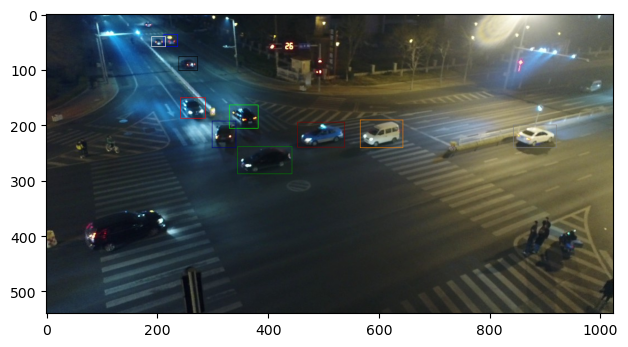

/tmp/ipykernel_476040/300231435.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(self.net_path)


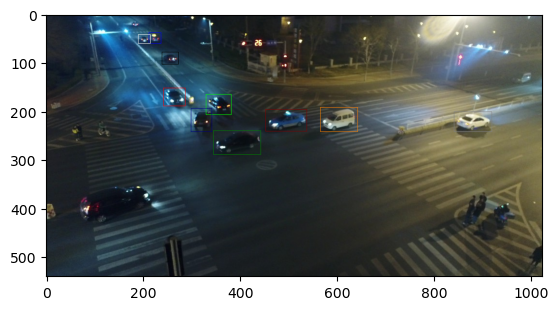

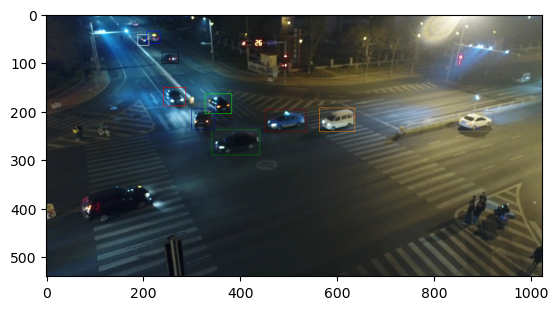

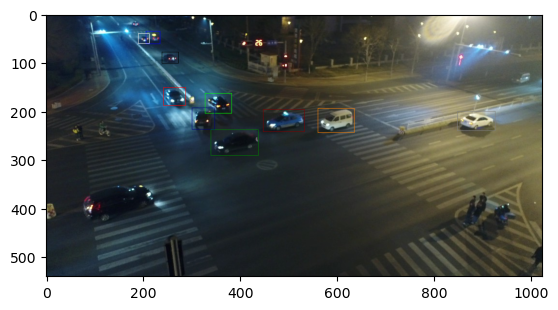

FPS: 32.064501497101354
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0701
init_bbox True


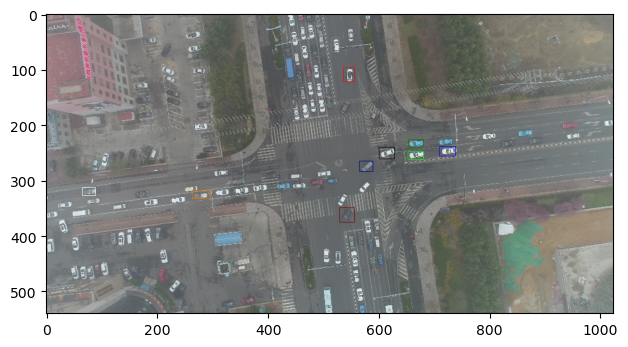

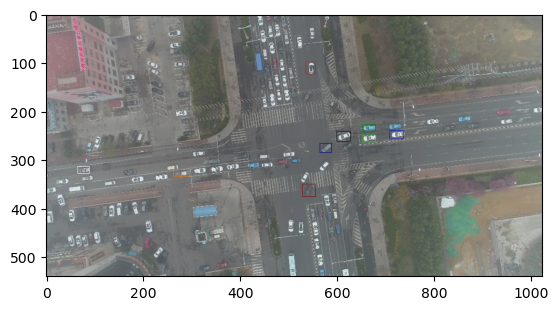

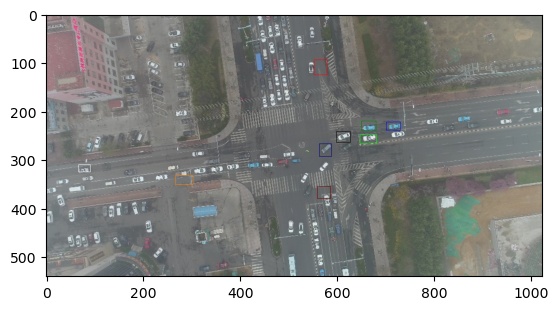

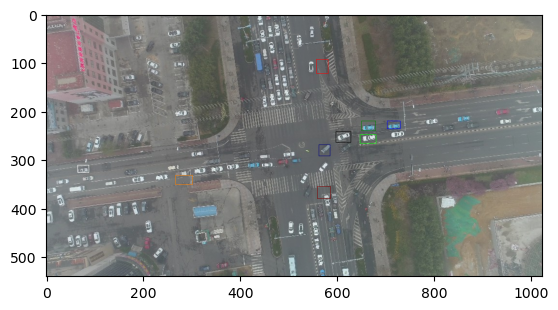

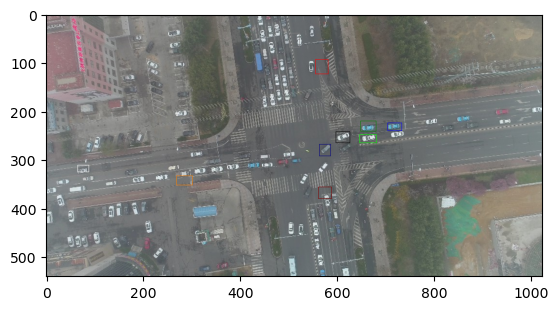

...

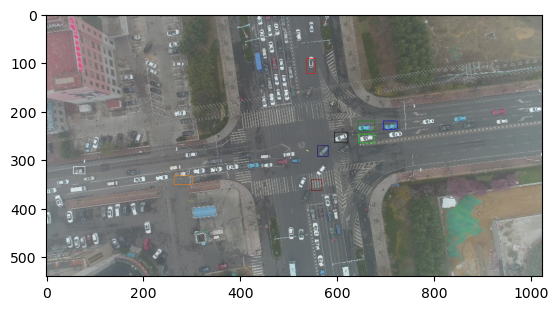

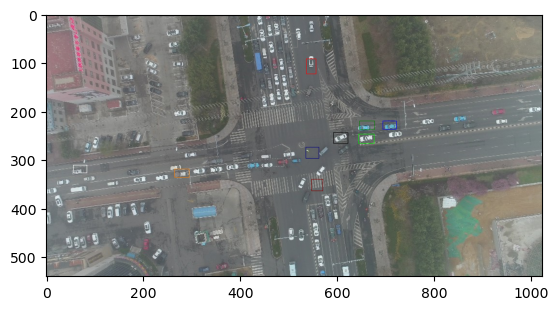

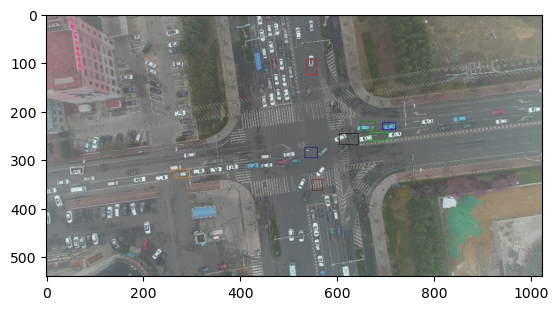

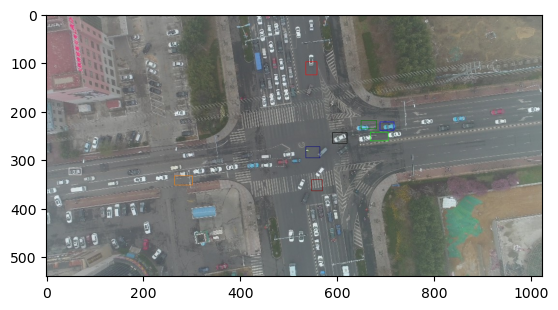

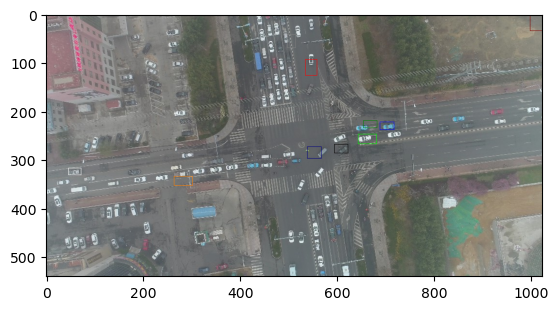

FPS: 28.87024327695499
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0704
init_bbox True


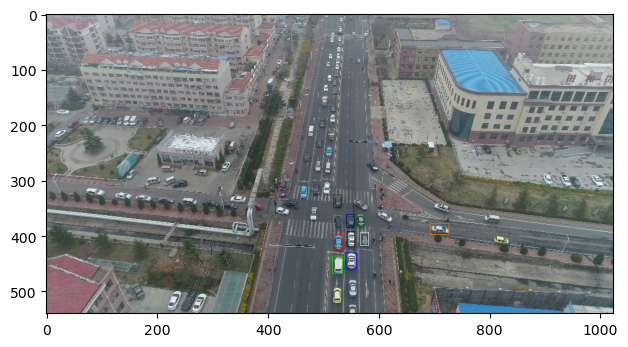

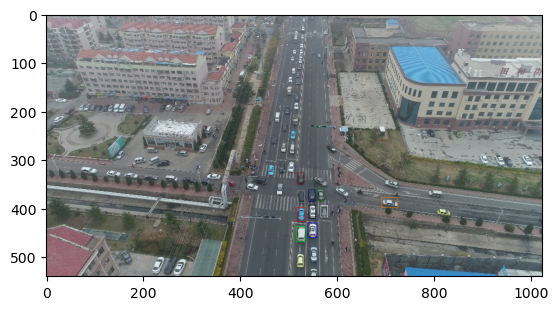

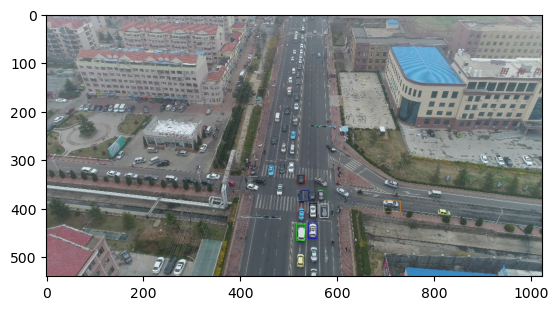

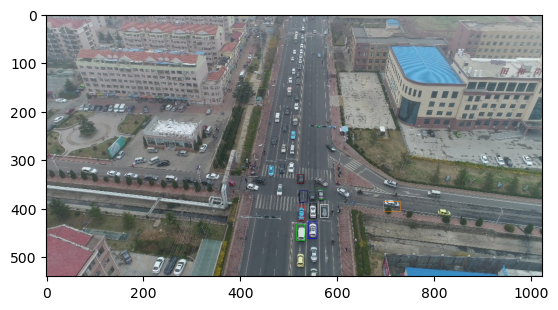

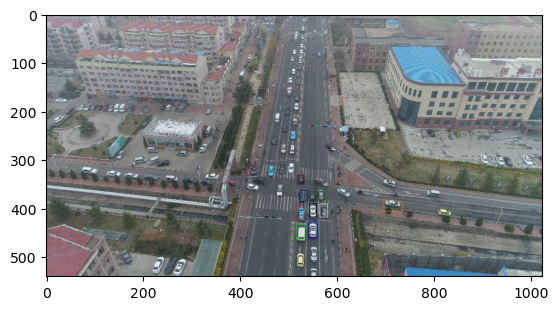

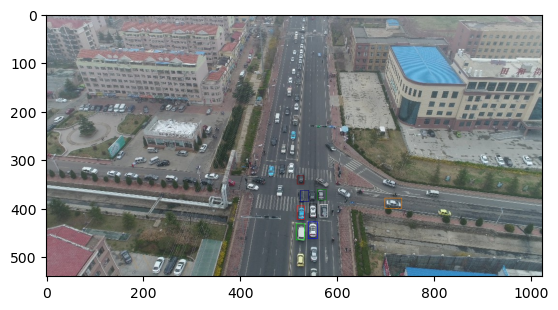

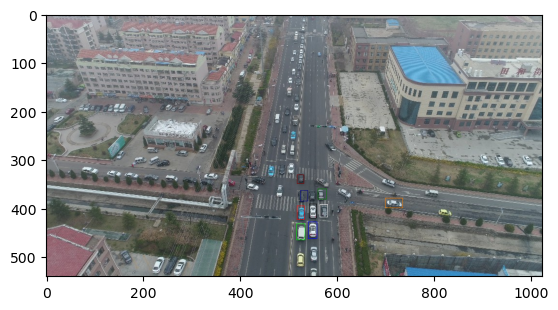

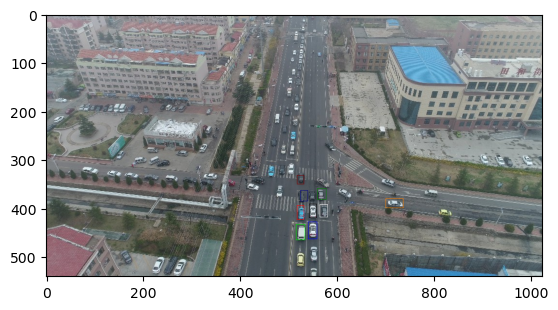

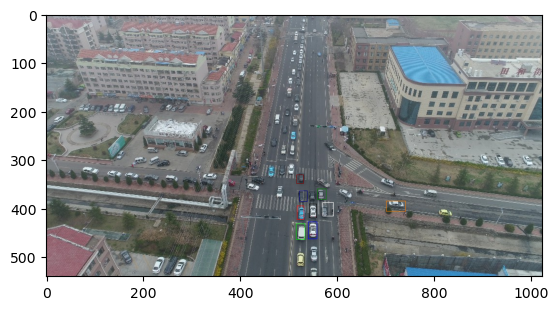

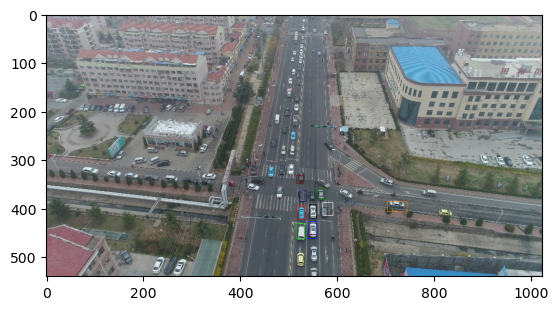

FPS: 26.613134991275533
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M1101
init_bbox True


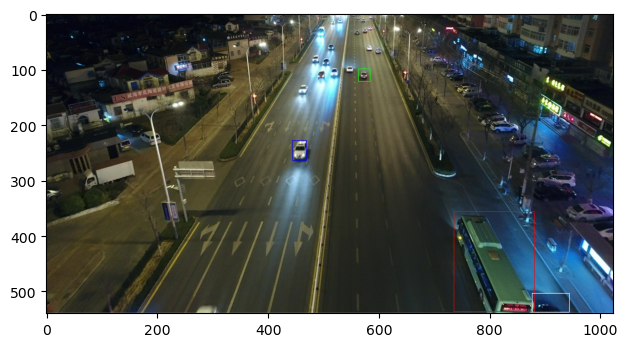

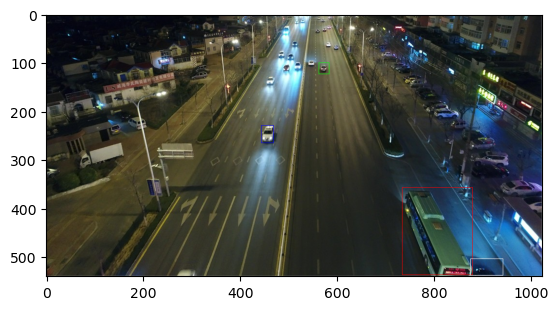

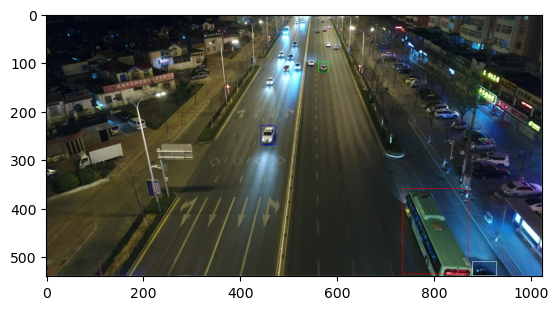

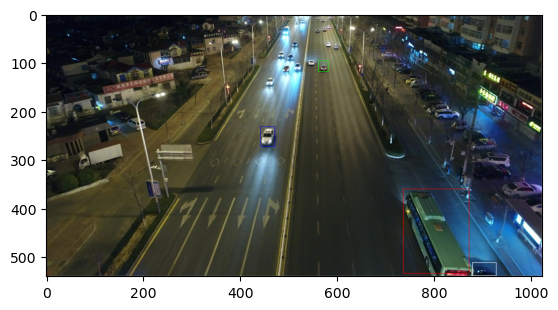

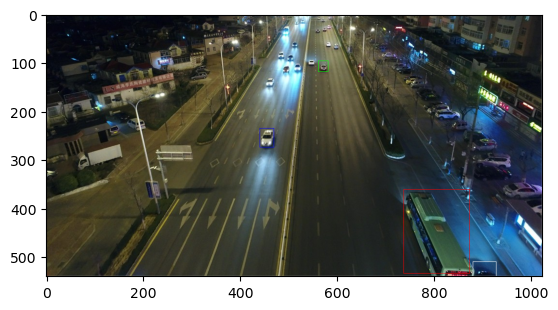

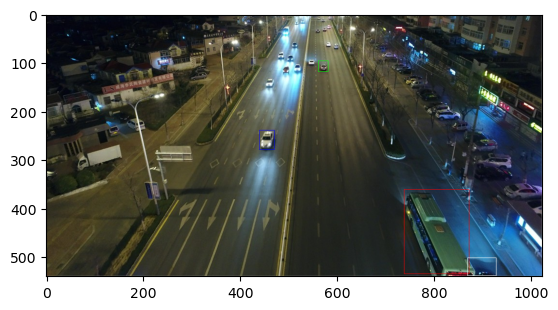

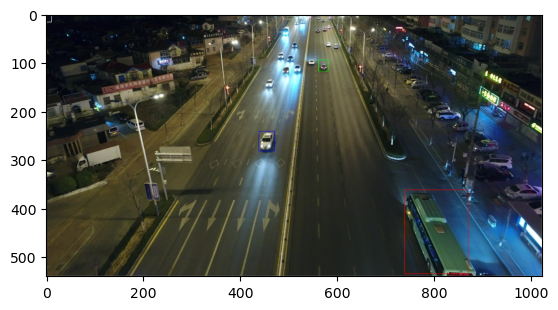

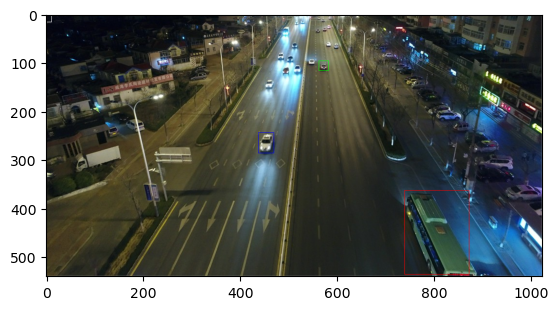

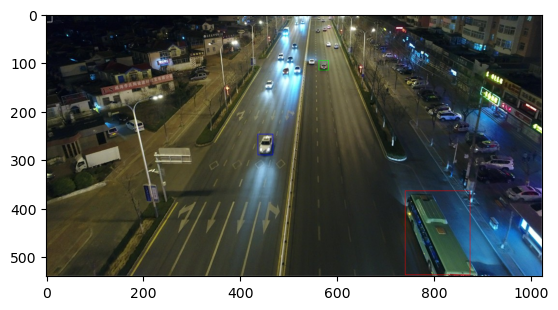

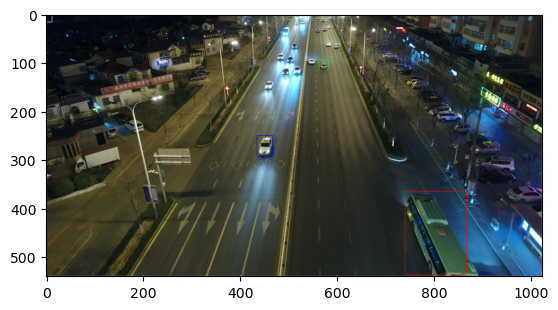

FPS: 31.63408819124892
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M1004
init_bbox True


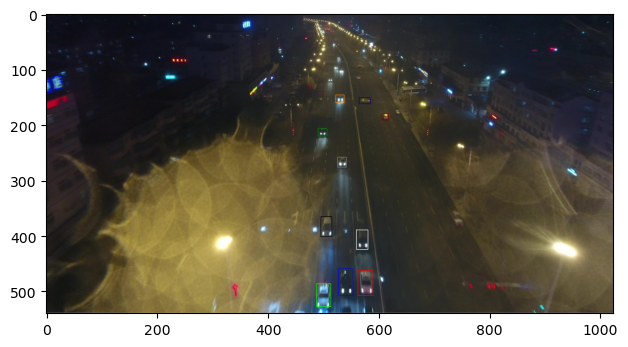

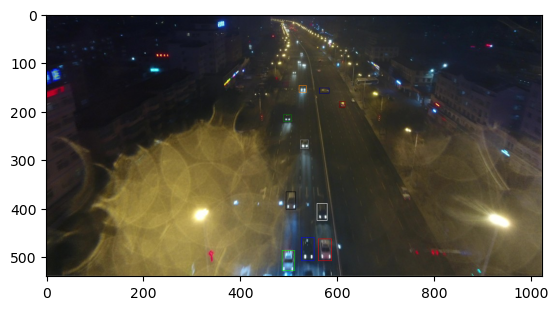

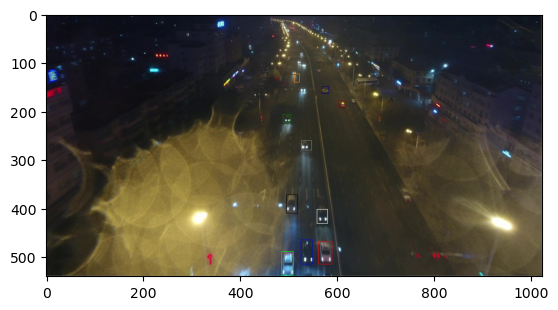

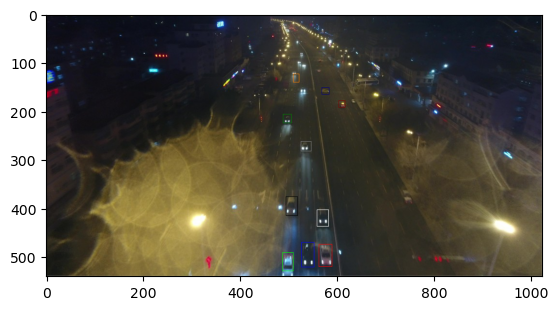

FPS: 37.27430860013745
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M1202
init_bbox True


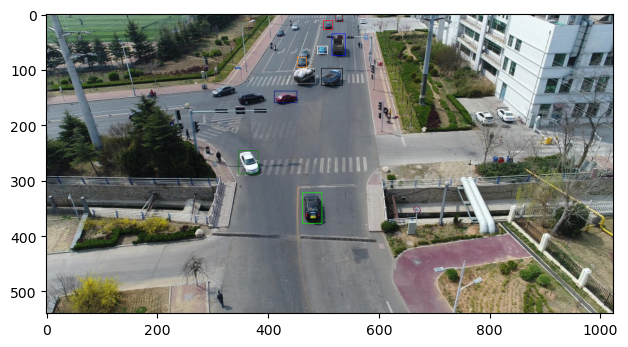

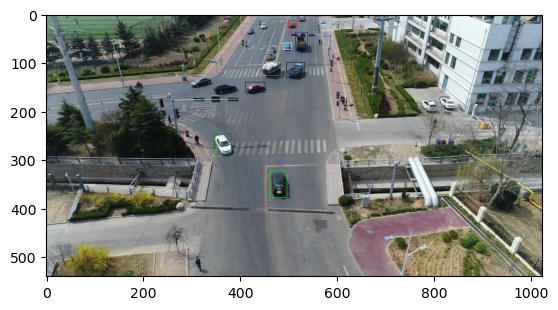

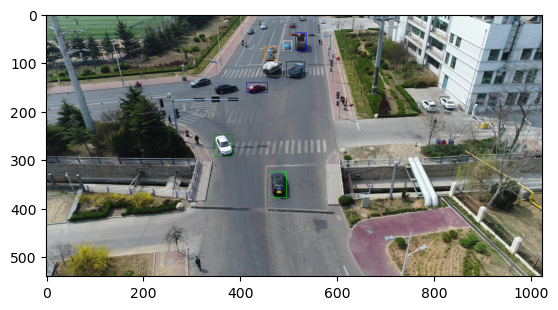

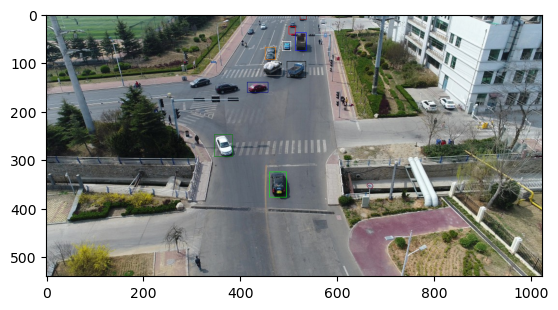

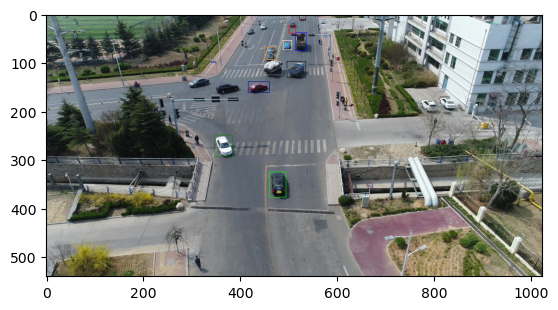

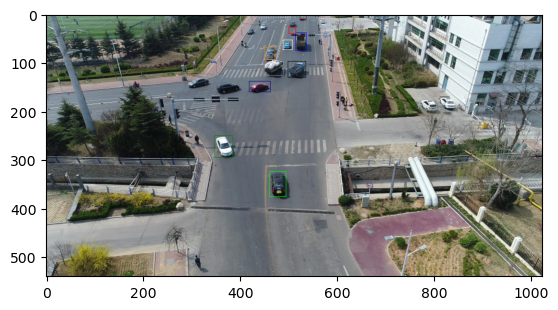

FPS: 32.046649939028676
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0501
init_bbox True


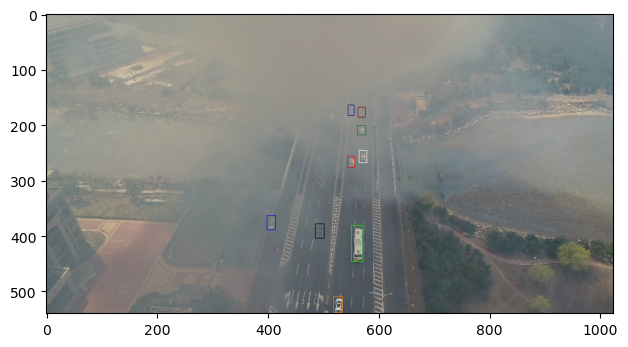

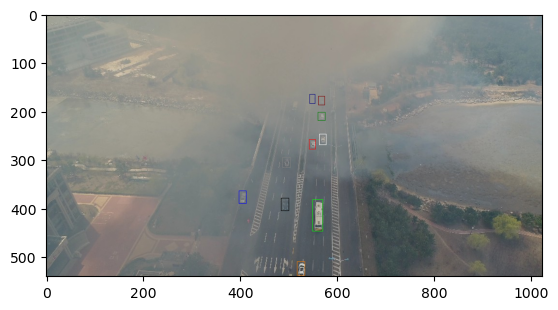

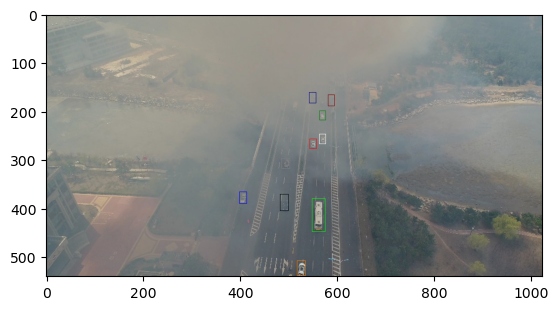

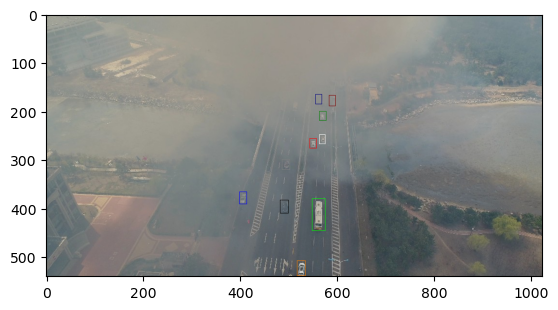

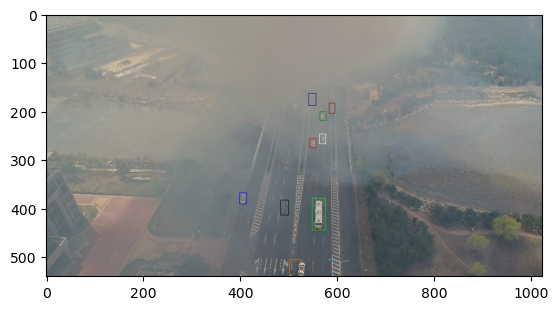

FPS: 32.59053435589019
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0201
init_bbox True


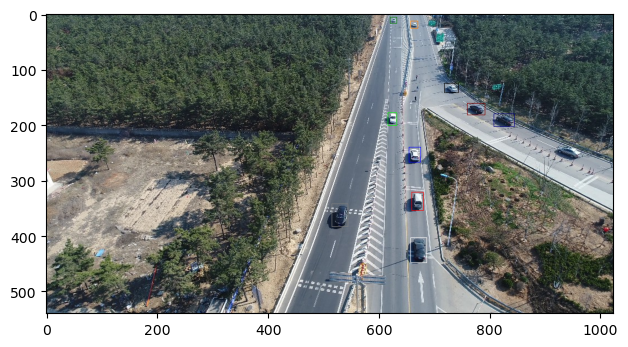

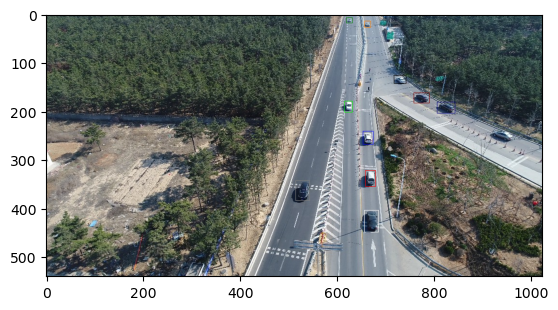

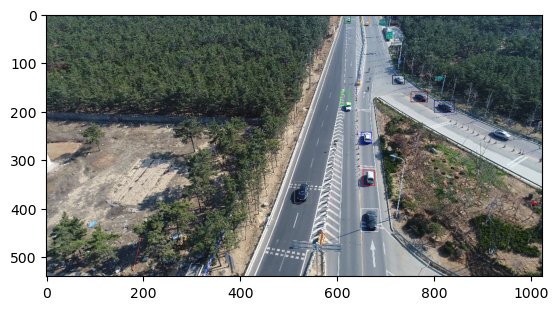

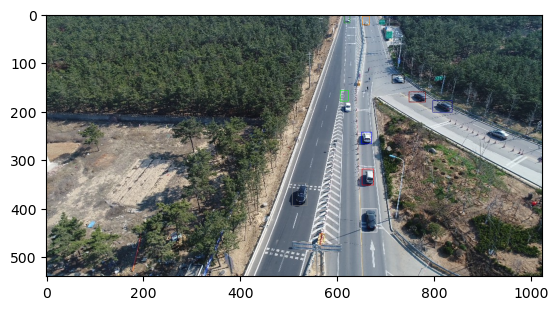

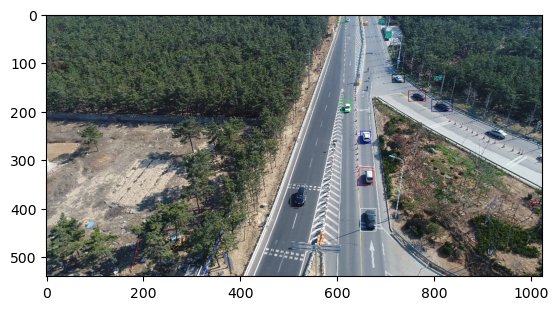

...

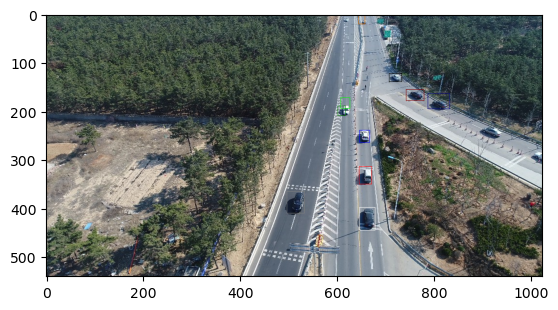

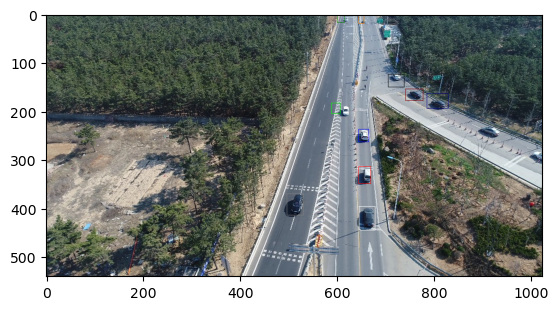

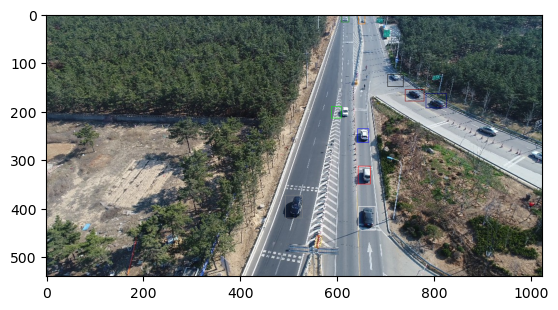

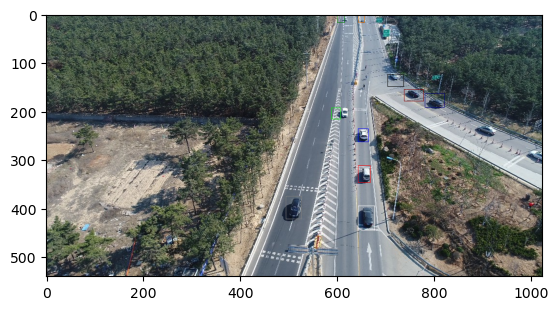

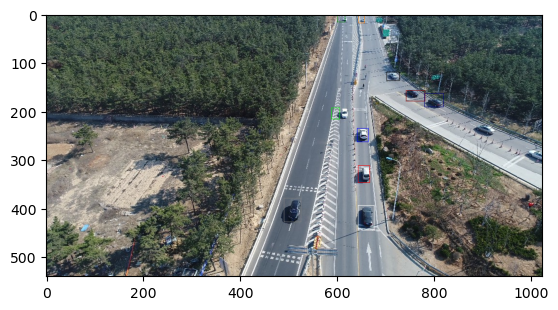

FPS: 28.223875812691322
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0208
init_bbox True


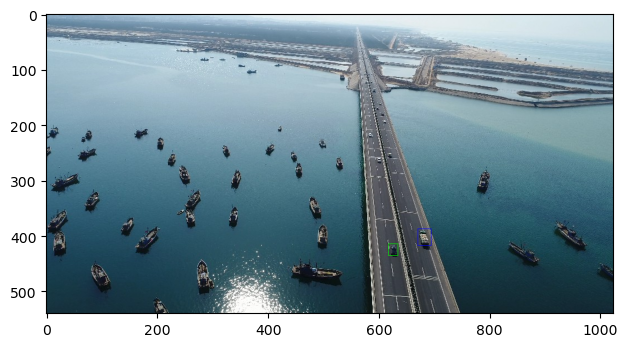

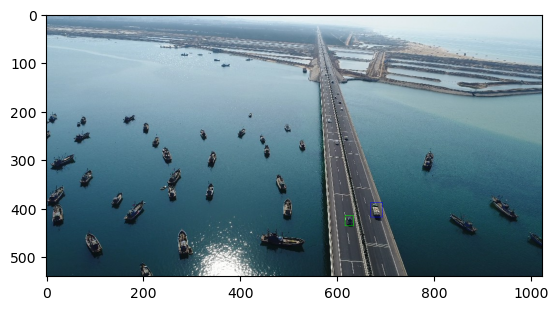

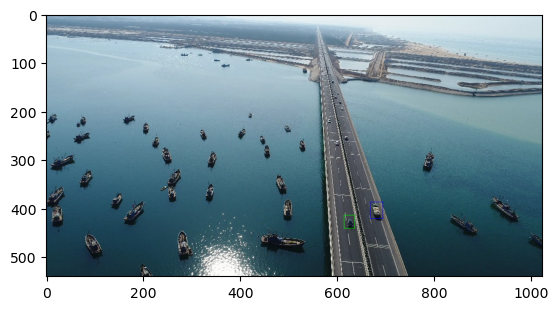

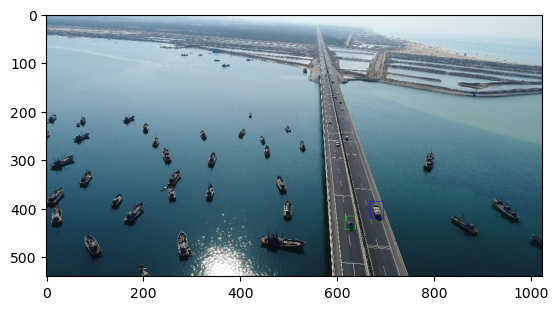

FPS: 39.440290624598404
Tracker: tamos tamos_tracking_parameters 0 ,  Sequence: M0204
init_bbox True


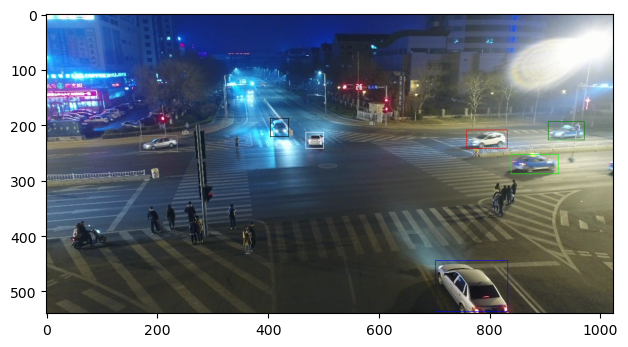

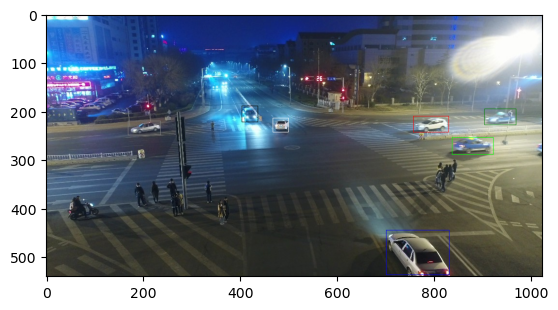

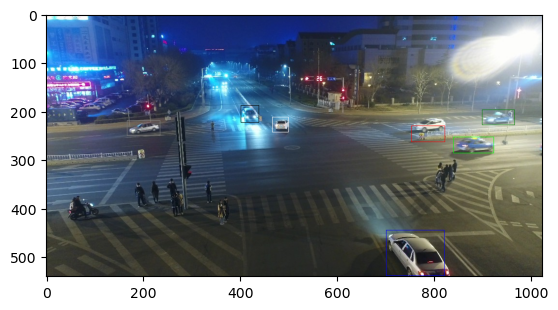

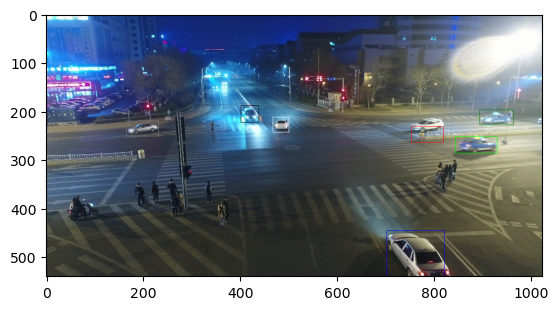

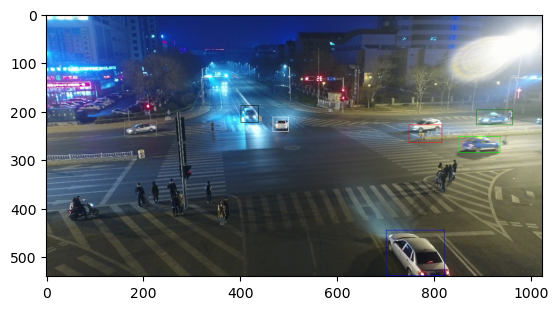

FPS: 32.55486735279964
Done


In [34]:
run_dataset(tracker_dataset, trackers, True, 0, visdom_info=None)